# RBM and Autoencoder testing
Playing with RBMs and Autoencoders, based on code from github user 'Cospel'
## Both Autoencoders with RBM pre-training and with RANDOM initialization of weights.

Using the code from https://github.com/Cospel/rbm-ae-tf
Sticking all code into one Notebook, running for Python 3.6 and TensorFlow 1.0.x

Author: Endre Stølsvik, 2017-05-04 00:10 - but it is basically just musings around the code from Cospel..

In [ ]:
# Prerequisites, in addition to tensorflow and some other stuff:
# conda install scikit-learn
# conda install pillow     # For the 'from PIL import Image'
# conda install matplotlib
# conda install keras

import tensorflow as tf

# Define the Transfer Function used for the RBMs and the subsequent Autoencoder employing pre-trained weights
# main_transfer = tf.nn.softsign # Doesn't work..
# main_transfer = tf.nn.tanh     # Non-good results - got 0.0 as cost for 2nd RBM..
main_transfer = tf.nn.sigmoid   # The one that work

# NOTICE! There are also several variants of Autoencoder with RANDOM init,
#         employing different transfer functions

rbm_epochs = 5
rbm_batchsize = 10  # Should evidently train with small batch sizes like 10, according to comments in the code.

autoencoder_epochs = 5  # NOTE: The final 2-node layer are plotted for each Epoch!
autoenc_batchsize = 25


In [2]:
# File: util.py

""" This file contains different utility functions that are not connected
in anyway to the networks presented in the tutorials, but rather help in
processing the outputs into a more understandable way.
For example ``tile_raster_images`` helps in generating a easy to grasp
image from a set of samples or weights.
"""

import numpy


def scale_to_unit_interval(ndar, eps=1e-8):
    """ Scales all values in the ndarray ndar to be between 0 and 1 """
    ndar = ndar.copy()
    ndar -= ndar.min()
    ndar *= 1.0 / (ndar.max() + eps)
    return ndar


def tile_raster_images(X, img_shape, tile_shape, tile_spacing=(0, 0),
                       scale_rows_to_unit_interval=True,
                       output_pixel_vals=True):
    """
    Transform an array with one flattened image per row, into an array in
    which images are reshaped and layed out like tiles on a floor.
    This function is useful for visualizing datasets whose rows are images,
    and also columns of matrices for transforming those rows
    (such as the first layer of a neural net).
    :type X: a 2-D ndarray or a tuple of 4 channels, elements of which can
    be 2-D ndarrays or None;
    :param X: a 2-D array in which every row is a flattened image.
    :type img_shape: tuple; (height, width)
    :param img_shape: the original shape of each image
    :type tile_shape: tuple; (rows, cols)
    :param tile_shape: the number of images to tile (rows, cols)
    :param output_pixel_vals: if output should be pixel values (i.e. int8
    values) or floats
    :param scale_rows_to_unit_interval: if the values need to be scaled before
    being plotted to [0,1] or not
    :returns: array suitable for viewing as an image.
    (See:`Image.fromarray`.)
    :rtype: a 2-d array with same dtype as X.
    """

    assert len(img_shape) == 2
    assert len(tile_shape) == 2
    assert len(tile_spacing) == 2

    # The expression below can be re-written in a more C style as
    # follows :
    #
    # out_shape    = [0,0]
    # out_shape[0] = (img_shape[0]+tile_spacing[0])*tile_shape[0] -
    #                tile_spacing[0]
    # out_shape[1] = (img_shape[1]+tile_spacing[1])*tile_shape[1] -
    #                tile_spacing[1]
    out_shape = [
        (ishp + tsp) * tshp - tsp
        for ishp, tshp, tsp in zip(img_shape, tile_shape, tile_spacing)
    ]

    if isinstance(X, tuple):
        assert len(X) == 4
        # Create an output numpy ndarray to store the image
        if output_pixel_vals:
            out_array = numpy.zeros((out_shape[0], out_shape[1], 4),
                                    dtype='uint8')
        else:
            out_array = numpy.zeros((out_shape[0], out_shape[1], 4),
                                    dtype=X.dtype)

        #colors default to 0, alpha defaults to 1 (opaque)
        if output_pixel_vals:
            channel_defaults = [0, 0, 0, 255]
        else:
            channel_defaults = [0., 0., 0., 1.]

        for i in range(4):
            if X[i] is None:
                # if channel is None, fill it with zeros of the correct
                # dtype
                dt = out_array.dtype
                if output_pixel_vals:
                    dt = 'uint8'
                out_array[:, :, i] = numpy.zeros(
                    out_shape,
                    dtype=dt
                ) + channel_defaults[i]
            else:
                # use a recurrent call to compute the channel and store it
                # in the output
                out_array[:, :, i] = tile_raster_images(
                    X[i], img_shape, tile_shape, tile_spacing,
                    scale_rows_to_unit_interval, output_pixel_vals)
        return out_array

    else:
        # if we are dealing with only one channel
        H, W = img_shape
        Hs, Ws = tile_spacing

        # generate a matrix to store the output
        dt = X.dtype
        if output_pixel_vals:
            dt = 'uint8'
        out_array = numpy.zeros(out_shape, dtype=dt)

        for tile_row in range(tile_shape[0]):
            for tile_col in range(tile_shape[1]):
                if tile_row * tile_shape[1] + tile_col < X.shape[0]:
                    this_x = X[tile_row * tile_shape[1] + tile_col]
                    if scale_rows_to_unit_interval:
                        # if we should scale values to be between 0 and 1
                        # do this by calling the `scale_to_unit_interval`
                        # function
                        this_img = scale_to_unit_interval(
                            this_x.reshape(img_shape))
                    else:
                        this_img = this_x.reshape(img_shape)
                    # add the slice to the corresponding position in the
                    # output array
                    c = 1
                    if output_pixel_vals:
                        c = 255
                    out_array[
                        tile_row * (H + Hs): tile_row * (H + Hs) + H,
                        tile_col * (W + Ws): tile_col * (W + Ws) + W
                    ] = this_img * c
        return out_array

In [3]:
# File: utilsnn.py

import numpy as np
import sklearn.preprocessing as prep
from PIL import Image


def show_image(path, n_w, img_shape, tile_shape):
    image = Image.fromarray(
        tile_raster_images(X=n_w.T, img_shape=img_shape, tile_shape=tile_shape, tile_spacing=(1, 1))
    )
    image.save(path)


def get_random_block_from_data(data, batch_size):
    start_index = np.random.randint(0, len(data) - batch_size)
    return data[start_index:(start_index + batch_size)]


def min_max_scale(X_train, X_test):
    preprocessor = prep.MinMaxScaler().fit(np.concatenate((X_train, X_test), axis=0))
    X_train = preprocessor.transform(X_train)
    X_test = preprocessor.transform(X_test)
    return X_train, X_test


def mean_normalization(X_train, X_test):
    data = np.concatenate((X_train, X_test), axis=0)
    mean = data.mean(axis=0)
    std = data.std(axis=0)
    return (X_train - mean) / std, (X_test - mean) / std


def xavier_init(fan_in, fan_out, function):
    if function is tf.nn.sigmoid:
        low = -4.0 * np.sqrt(6.0 / (fan_in + fan_out))
        high = 4.0 * np.sqrt(6.0 / (fan_in + fan_out))
        return tf.random_uniform((fan_in, fan_out), minval=low, maxval=high, dtype=tf.float32)
    else:
        low = -1 * np.sqrt(6.0 / (fan_in + fan_out))
        high = 1 * np.sqrt(6.0 / (fan_in + fan_out))
        return tf.random_uniform((fan_in, fan_out), minval=low, maxval=high, dtype=tf.float32)

In [4]:
# File: rbm.py

import tensorflow as tf
import numpy as np


class RBM(object):
    def __init__(self, n_input, n_hidden, layer_names, alpha=1.0, transfer_function=tf.nn.sigmoid):
        self.n_input = n_input
        self.n_hidden = n_hidden
        self.transfer = transfer_function
        self.layer_names = layer_names

        network_weights = self._initialize_weights()
        self.weights = network_weights

        # placeholders
        self.x = tf.placeholder(tf.float32, [None, self.n_input])
        self.rbm_w = tf.placeholder(tf.float32,[self.n_input, self.n_hidden])
        self.rbm_vb = tf.placeholder(tf.float32,[self.n_input])
        self.rbm_hb = tf.placeholder(tf.float32,[self.n_hidden])

        # variables
        # The weights are initialized to small random values chosen from a zero-mean Gaussian with a
        # standard deviation of about 0.01. It is usually helpful to initialize the bias of visible unit
        # i to log[pi/(1?pi)] where pi is the proportion of training vectors in which unit i is on.
        # Otherwise, initial hidden biases of 0 are usually fine.  It is also possible to start the hidden
        # units with quite large negative biases of about ?4 as a crude way of encouraging sparsity.
        self.n_w = np.zeros([self.n_input, self.n_hidden], np.float32)
        self.n_vb = np.zeros([self.n_input], np.float32)
        self.n_hb = np.zeros([self.n_hidden], np.float32)
        self.o_w = np.random.normal(0.0, 0.01, [self.n_input, self.n_hidden])
        self.o_vb = np.zeros([self.n_input], np.float32)
        self.o_hb = np.zeros([self.n_hidden], np.float32)

        # model/training/performing one Gibbs sample.
        # RBM is generative model, who tries to encode in weights the understanding of data.
        # RBMs typically learn better models if more steps of alternating Gibbs sampling are used.
        
        # 1. set visible state to training sample(x) and compute hidden state(h0) of data
        #    then we have binary units of hidden state computed. It is very important to make these
        #    hidden states binary, rather than using the probabilities themselves. (see Hinton paper)
        self.h0prob = transfer_function(tf.matmul(self.x, self.rbm_w) + self.rbm_hb)
        self.h0 = self.sample_prob(self.h0prob)
        # 2. compute new visible state of reconstruction based on computed hidden state reconstruction.
        #    However, it is common to use the probability, instead of sampling a binary value.
        #    So this can be binary or probability (so i choose to not use sampled probability)
        self.v1 = transfer_function(tf.matmul(self.h0prob, tf.transpose(self.rbm_w)) + self.rbm_vb)
        # 3. compute new hidden state of reconstruction based on computed visible reconstruction
        #    When hidden units are being driven by reconstructions, always use probabilities without sampling.
        self.h1 = tf.nn.sigmoid(tf.matmul(self.v1, self.rbm_w) + self.rbm_hb)

        # compute gradients
        self.w_positive_grad = tf.matmul(tf.transpose(self.x), self.h0)
        self.w_negative_grad = tf.matmul(tf.transpose(self.v1), self.h1)

        # stochastic steepest ascent because we need to maximalize log likelihood of p(visible)
        # dlog(p)/dlog(w) = (visible * hidden)_data - (visible * hidden)_reconstruction
        self.update_w = self.rbm_w + alpha * (self.w_positive_grad - self.w_negative_grad) / tf.to_float(tf.shape(self.x)[0])
        self.update_vb = self.rbm_vb + alpha * tf.reduce_mean(self.x - self.v1, 0)
        self.update_hb = self.rbm_hb + alpha * tf.reduce_mean(self.h0prob  - self.h1, 0)

        # sampling functions
        self.h_sample = transfer_function(tf.matmul(self.x, self.rbm_w) + self.rbm_hb)
        self.v_sample = transfer_function(tf.matmul(self.h_sample, tf.transpose(self.rbm_w)) + self.rbm_vb)

        # cost
        self.err_sum = tf.reduce_mean(tf.square(self.x - self.v_sample))

        self.sess = tf.Session()
        self.sess.run(tf.global_variables_initializer())

    def compute_cost(self, batch):
        # Use it but don?t trust it. If you really want to know what is going on use multiple histograms.
        # Although it is convenient, the reconstruction error is actually a very poor measure of the progress.
        # As the weights increase the mixing rate falls, so decreases in reconstruction error do not
        # necessarily mean that the model is improving. Small increases do not necessarily mean the model
        # is getting worse.
        return self.sess.run(self.err_sum, feed_dict={self.x: batch, self.rbm_w: self.o_w,
                                                      self.rbm_vb: self.o_vb, self.rbm_hb: self.o_hb})

    def sample_prob(self, probs):
        return tf.nn.relu(tf.sign(probs - tf.random_uniform(tf.shape(probs))))

    def _initialize_weights(self):
        # These weights are only for storing and loading model for tensorflow Saver.
        all_weights = dict()
        all_weights['w'] = tf.Variable(tf.random_normal([self.n_input, self.n_hidden], stddev=0.01, dtype=tf.float32),
                                       name=self.layer_names[0])
        all_weights['vb'] = tf.Variable(tf.zeros([self.n_input], dtype=tf.float32), name=self.layer_names[1])
        all_weights['hb'] = tf.Variable(tf.random_uniform([self.n_hidden], dtype=tf.float32), name=self.layer_names[2])
        return all_weights

    def transform(self, batch_x):
        return self.sess.run(self.h_sample, {self.x: batch_x, 
                                             self.rbm_w: self.o_w,
                                             # self.rbm_vb: self.o_vb, 
                                             self.rbm_hb: self.o_hb})

    def save_weights(self, path):
        self.sess.run(self.weights['w'].assign(self.o_w))
        self.sess.run(self.weights['vb'].assign(self.o_vb))
        self.sess.run(self.weights['hb'].assign(self.o_hb))

        saver = tf.train.Saver({self.layer_names[0]: self.weights['w'],
                                self.layer_names[1]: self.weights['vb'],
                                self.layer_names[2]: self.weights['hb']})
        save_path = saver.save(self.sess, path)

    def restore_weights(self, path):
        saver = tf.train.Saver({self.layer_names[0]: self.weights['w'],
                                self.layer_names[1]: self.weights['vb'],
                                self.layer_names[2]: self.weights['hb']})
        saver.restore(self.sess, path)

        self.o_w = self.weights['w'].eval(self.sess)
        self.o_vb = self.weights['vb'].eval(self.sess)
        self.o_hb = self.weights['hb'].eval(self.sess)

    def return_weights(self):
        return self.weights

    def return_hidden_weight_as_np(self):
        return self.n_w

    def partial_fit(self, batch_x):
        # 1. always use small mini-batches of 10 to 100 cases.
        #    For big data with lot of classes use mini-batches of size about 10.
        self.n_w, self.n_vb, self.n_hb = self.sess.run([self.update_w, self.update_vb, self.update_hb],
                                                       feed_dict={self.x: batch_x, 
                                                                  self.rbm_w: self.o_w,
                                                                  self.rbm_vb: self.o_vb,
                                                                  self.rbm_hb: self.o_hb})
        self.o_w = self.n_w
        self.o_vb = self.n_vb
        self.o_hb = self.n_hb

        error = self.sess.run(self.err_sum, feed_dict={self.x: batch_x, 
                                                       self.rbm_w: self.n_w,
                                                       self.rbm_vb: self.n_vb,
                                                       self.rbm_hb: self.n_hb})
        return error

In [ ]:
# File: au.py

import tensorflow as tf

class AutoEncoder(object):
    def __init__(self, input_size, layer_sizes, layer_names, tied_weights=False, 
                 optimizer=tf.train.AdamOptimizer(learning_rate=0.0005),
                 transfer_function=tf.nn.sigmoid):

        self.layer_names  = layer_names
        self.tied_weights = tied_weights


        assert len(layer_sizes) == len(layer_names)

        self.encoding_matrices = []
        self.encoding_biases = []

        # Build the encoding layers
        self.x = tf.placeholder("float", [None, input_size])
        next_layer_input = self.x
        for i in range(len(layer_sizes)):
            dim = layer_sizes[i]
            input_dim = int(next_layer_input.get_shape()[1])

            # Initialize W using xavier initialization
            W = tf.get_variable(layer_names[i][0]+'-encodeW',
                                shape=[input_dim, dim],
                                initializer=tf.contrib.layers.xavier_initializer())

            # Initialize b to zero
            b = tf.Variable(tf.zeros([dim]), name=layer_names[i][1])

            # We are going to use tied-weights so store the W matrix for later reference.
            self.encoding_matrices.append(W)
            self.encoding_biases.append(b)

            output = transfer_function(tf.matmul(next_layer_input, W) + b)

            # the input into the next layer is the output of this layer
            next_layer_input = output

        # The fully encoded x value is now stored in the next_layer_input
        self.encoded_x = output

        # build the reconstruction layers by reversing the reductions
        layer_sizes.reverse()
        self.encoding_matrices.reverse()

        self.decoding_matrices = []
        self.decoding_biases = []

        for i, dim in enumerate(layer_sizes[1:] + [int(self.x.get_shape()[1])]):
            W = None
            # if we are using tied weights, so just lookup the encoding matrix for this step and transpose it
            if tied_weights:
                # Tied weights, look up encoding matrix
                W = tf.identity(tf.transpose(self.encoding_matrices[i]))
            else:
                # Initialize W using xavier initialization
                W = tf.get_variable(layer_names[i][0]+'-decodeW', 
                                    shape=tf.transpose(self.encoding_matrices[i]).get_shape(),
                                    initializer=tf.contrib.layers.xavier_initializer())
            
            b = tf.Variable(tf.zeros([dim]))
            self.decoding_matrices.append(W)
            self.decoding_biases.append(b)

            output = transfer_function(tf.matmul(next_layer_input, W) + b)
            next_layer_input = output

        # Need to reverse the encoding matrices back for loading weights
        self.encoding_matrices.reverse()
        self.decoding_matrices.reverse()

        # The fully encoded, then reconstructed value of x is here:
        self.reconstructed_x = next_layer_input

        # compute cost
        self.cost = tf.sqrt(tf.reduce_mean(tf.square(self.x - self.reconstructed_x)))
        self.optimizer = optimizer.minimize(self.cost)

        # initalize variables
        self.sess = tf.Session()
        self.sess.run(tf.global_variables_initializer())

    def transform(self, X):
        return self.sess.run(self.encoded_x, {self.x: X})

    def reconstruct(self, X):
        return self.sess.run(self.reconstructed_x, feed_dict={self.x: X})

    def load_rbm_weights(self, path, layer_names, layer):
        saver = tf.train.Saver({layer_names[0]: self.encoding_matrices[layer]},
                               {layer_names[1]: self.encoding_biases[layer]})
        saver.restore(self.sess, path)

        if not self.tied_weights:
            self.sess.run(self.decoding_matrices[layer].assign(tf.transpose(self.encoding_matrices[layer])))

    def print_weights(self):
        print('Matrices')
        for i in range(len(self.encoding_matrices)):
            print('Matrice',i)
            print(self.encoding_matrices[i].eval(self.sess).shape)
            print(self.encoding_matrices[i].eval(self.sess))
            if not self.tied_weights:
                print(self.decoding_matrices[i].eval(self.sess).shape)
                print(self.decoding_matrices[i].eval(self.sess))

    def load_weights(self, path):
        dict_w = self.get_dict_layer_names() 
        saver = tf.train.Saver(dict_w)
        saver.restore(self.sess, path)

    def save_weights(self, path):
        dict_w = self.get_dict_layer_names()
        saver = tf.train.Saver(dict_w)
        save_path = saver.save(self.sess, path)

    def get_dict_layer_names(self):
        dict_w = {}
        for i in range(len(self.layer_names)):
            dict_w[self.layer_names[i][0]] = self.encoding_matrices[i]
            dict_w[self.layer_names[i][1]] = self.encoding_biases[i]
            if not self.tied_weights:
                dict_w[self.layer_names[i][0]+'d'] = self.decoding_matrices[i]
                dict_w[self.layer_names[i][1]+'d'] = self.decoding_biases[i]
        return dict_w

    def partial_fit(self, X):
        cost, opt = self.sess.run((self.cost, self.optimizer), feed_dict={self.x: X})
        return cost

In [6]:
# File: test-ae-rbm.py

import tensorflow as tf
import tensorflow.examples.tutorials.mnist.input_data as input_data
import numpy as np

mnist = input_data.read_data_sets("tmp", one_hot=True)

trX, trY, teX, teY = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
trX, teX = min_max_scale(trX, teX)

# RBMs
rbmobject1 = RBM(784, 900, ['rbmw1', 'rbvb1', 'rbmhb1'], 0.3, transfer_function=main_transfer)
rbmobject2 = RBM(900, 500, ['rbmw2', 'rbvb2', 'rbmhb2'], 0.3, transfer_function=main_transfer)
rbmobject3 = RBM(500, 250, ['rbmw3', 'rbvb3', 'rbmhb3'], 0.3, transfer_function=main_transfer)
rbmobject4 = RBM(250, 2,   ['rbmw4', 'rbvb4', 'rbmhb4'], 0.3, transfer_function=main_transfer)

#rbmobject1.restore_weights('./rbmw1.chp')
#rbmobject2.restore_weights('./rbmw2.chp')
#rbmobject3.restore_weights('./rbmw3.chp')
#rbmobject4.restore_weights('./rbmw4.chp')

rbm_iterations = int(len(trX)/rbm_batchsize)

# Train First RBM
print('# First rbm')
cost = rbmobject1.compute_cost(trX)
print("  Before training cost=", "{:.9f}".format(cost))
for i in range(rbm_epochs):
  for j in range(rbm_iterations):
    batch_xs, batch_ys = mnist.train.next_batch(rbm_batchsize)
    rbmobject1.partial_fit(batch_xs)
  cost = rbmobject1.compute_cost(trX)
  print("  Epoch:", '%04d' % (i+1), "cost=", "{:.9f}".format(cost))
  show_image("1rbm.jpg", rbmobject1.n_w, (28, 28), (30, 30))
rbmobject1.save_weights('./rbmw1.chp')

# Train Second RBM
print('# Second rbm')
cost = rbmobject2.compute_cost(rbmobject1.transform(trX))
print("  Before training cost=", "{:.9f}".format(cost))
for i in range(rbm_epochs):
  for j in range(rbm_iterations):
    batch_xs, batch_ys = mnist.train.next_batch(rbm_batchsize)
    # Transform features with first rbm for second rbm
    batch_xs = rbmobject1.transform(batch_xs)
    rbmobject2.partial_fit(batch_xs)
  cost = rbmobject2.compute_cost(rbmobject1.transform(trX))
  print("  Epoch:", '%04d' % (i+1), "cost=", "{:.9f}".format(cost))
  show_image("2rbm.jpg", rbmobject2.n_w, (30, 30), (25, 20))
rbmobject2.save_weights('./rbmw2.chp')

# Train Third RBM
print('# Third rbm')
cost = rbmobject3.compute_cost(rbmobject2.transform(rbmobject1.transform(trX)))
print("  Before training cost=", "{:.9f}".format(cost))
for i in range(rbm_epochs):
  for j in range(rbm_iterations):
    batch_xs, batch_ys = mnist.train.next_batch(rbm_batchsize)
    # Transform features with first and second rbm for third rbm
    batch_xs = rbmobject1.transform(batch_xs)
    batch_xs = rbmobject2.transform(batch_xs)
    rbmobject3.partial_fit(batch_xs)
  cost = rbmobject3.compute_cost(rbmobject2.transform(rbmobject1.transform(trX)))
  print("  Epoch:", '%04d' % (i+1), "cost=", "{:.9f}".format(cost))
  show_image("3rbm.jpg", rbmobject3.n_w, (25, 20), (25, 10))
rbmobject3.save_weights('./rbmw3.chp')

# Train Third RBM
print('# Fourth rbm')
cost = rbmobject4.compute_cost(rbmobject3.transform(rbmobject2.transform(rbmobject1.transform(trX))))
print("  Before training cost=", "{:.9f}".format(cost))
for i in range(rbm_epochs):
  for j in range(rbm_iterations):
    batch_xs, batch_ys = mnist.train.next_batch(rbm_batchsize)
    # Transform features with first, second and third rbm for fourth rbm
    batch_xs = rbmobject1.transform(batch_xs)
    batch_xs = rbmobject2.transform(batch_xs)
    batch_xs = rbmobject3.transform(batch_xs)
    rbmobject4.partial_fit(batch_xs)
  cost = rbmobject4.compute_cost(rbmobject3.transform(rbmobject2.transform(rbmobject1.transform(trX))))
  print("  Epoch:", '%04d' % (i+1), "cost=", "{:.9f}".format(cost))
rbmobject4.save_weights('./rbmw4.chp')

Extracting tmp/train-images-idx3-ubyte.gz
Extracting tmp/train-labels-idx1-ubyte.gz
Extracting tmp/t10k-images-idx3-ubyte.gz
Extracting tmp/t10k-labels-idx1-ubyte.gz
# First rbm
  Before training cost= 0.232143477
  Epoch: 0001 cost= 0.011778138
  Epoch: 0002 cost= 0.011034033
  Epoch: 0003 cost= 0.010655437
  Epoch: 0004 cost= 0.009859283
  Epoch: 0005 cost= 0.009822271
# Second rbm
  Before training cost= 0.242740914
  Epoch: 0001 cost= 0.003455978
  Epoch: 0002 cost= 0.003201682
  Epoch: 0003 cost= 0.003092933
  Epoch: 0004 cost= 0.002991183
  Epoch: 0005 cost= 0.002912204
# Third rbm
  Before training cost= 0.229720250
  Epoch: 0001 cost= 0.006162269
  Epoch: 0002 cost= 0.005688589
  Epoch: 0003 cost= 0.005813235
  Epoch: 0004 cost= 0.005683944
  Epoch: 0005 cost= 0.005738731
# Fourth rbm
  Before training cost= 0.220753670
  Epoch: 0001 cost= 0.055598035
  Epoch: 0002 cost= 0.055502817
  Epoch: 0003 cost= 0.053552646
  Epoch: 0004 cost= 0.052704662
  Epoch: 0005 cost= 0.052862491


In [30]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.figsize'] = (16, 14)

def drawPlot(x, y):
    print('  X:', x)
    print('  Y:', y)

    fig, ax = plt.subplots()

    plt.scatter(x, y, c=np.argmax(teY, axis=1), alpha=0.2)
    plt.show()

  X: [  1.00000000e+00   9.55746648e-18   1.00000000e+00 ...,   1.00000000e+00
   9.99974489e-01   3.17178052e-15]
  Y: [  1.00000000e+00   8.74015953e-08   1.67389702e-25 ...,   9.58799303e-01
   8.60844466e-07   2.09797211e-02]


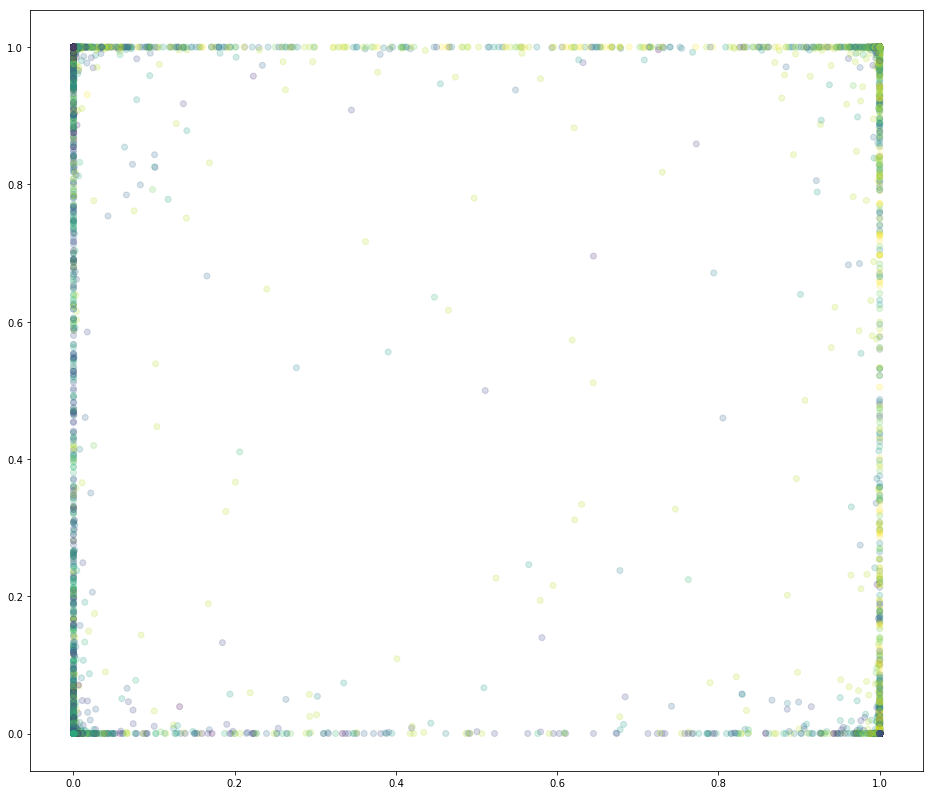

In [31]:
# Draw scatterplot of the resulting transformation directly through the RBMs
transformed = rbmobject1.transform(teX)
transformed = rbmobject2.transform(transformed)
transformed = rbmobject3.transform(transformed)
transformed = rbmobject4.transform(transformed)

drawPlot(transformed[:,0], transformed[:,1])

In [33]:
# Resetting default graph, since we're loading up everything, and to reset tf.get_variable names.
tf.reset_default_graph()

# Autoencoder with weight initialized from RBMs
autoencoder = AutoEncoder(784, [900, 500, 250, 2], [['rbmw1', 'rbmhb1'],
                                                    ['rbmw2', 'rbmhb2'],
                                                    ['rbmw3', 'rbmhb3'],
                                                    ['rbmw4', 'rbmhb4']], 
                          tied_weights=False, transfer_function=main_transfer)

# Load RBM weights to Autoencoder
autoencoder.load_rbm_weights('./rbmw1.chp', ['rbmw1', 'rbmhb1'], 0)
autoencoder.load_rbm_weights('./rbmw2.chp', ['rbmw2', 'rbmhb2'], 1)
autoencoder.load_rbm_weights('./rbmw3.chp', ['rbmw3', 'rbmhb3'], 2)
autoencoder.load_rbm_weights('./rbmw4.chp', ['rbmw4', 'rbmhb4'], 3)

# Save Autoencoder weights (loaded in the training method, if its parameter load_wights=True)
autoencoder.save_weights('./au.chp')

INFO:tensorflow:Restoring parameters from ./rbmw1.chp
INFO:tensorflow:Restoring parameters from ./rbmw2.chp
INFO:tensorflow:Restoring parameters from ./rbmw3.chp
INFO:tensorflow:Restoring parameters from ./rbmw4.chp


In [34]:
def trainAutoencoderAndPlot(transfer_function, epochs=5, load_weights=False):
    # Resetting default graph, since we're loading up everything, and to reset tf.get_variable names.
    tf.reset_default_graph()
    
    # Starting afresh
    autoencoder = AutoEncoder(784, [900, 500, 250, 2], [['rbmw1', 'rbmhb1'],
                                                        ['rbmw2', 'rbmhb2'],
                                                        ['rbmw3', 'rbmhb3'],
                                                        ['rbmw4', 'rbmhb4']], 
                              tied_weights=False, transfer_function=transfer_function)

    if (load_weights):
        autoencoder.load_weights('./au.chp')

    autoenc_iterations = int(len(trX)/autoenc_batchsize)

    # Train Autoencoder
    print('# Training Autoencoder with', ('PRE-TRAINED' if load_weights else 'RANDOM'), 'initialization of weights.')
    print("  Epochs:", epochs)
    print("  Transfer function:", transfer_function)
    print('')
    print('Before training:')
    # Plot the two-node result of the test images
    transformed = autoencoder.transform(teX)
    drawPlot(transformed[:,0], transformed[:,1])
    for i in range(epochs):
        # Run Epoch
        cost = 0.0
        for j in range(autoenc_iterations):
            batch_xs, batch_ys = mnist.train.next_batch(autoenc_batchsize)
            cost += autoencoder.partial_fit(batch_xs)
        print("  Epoch", i+1, "of", epochs, "-> Cost:", cost)

        # Plot the two-node result of the test images
        transformed = autoencoder.transform(teX)
        drawPlot(transformed[:,0], transformed[:,1])
    return plt

INFO:tensorflow:Restoring parameters from ./au.chp
# Training Autoencoder with PRE-TRAINED initialization of weights.
  Epochs: 5
  Transfer function: <function sigmoid at 0x7fea393daa60>

Before training:
  X: [  1.00000000e+00   2.88755332e-15   1.00000000e+00 ...,   9.99201715e-01
   3.51618916e-01   1.41939903e-14]
  Y: [  1.00000000e+00   2.12585623e-03   2.23255096e-18 ...,   9.98524964e-01
   9.61560190e-01   9.82517540e-01]


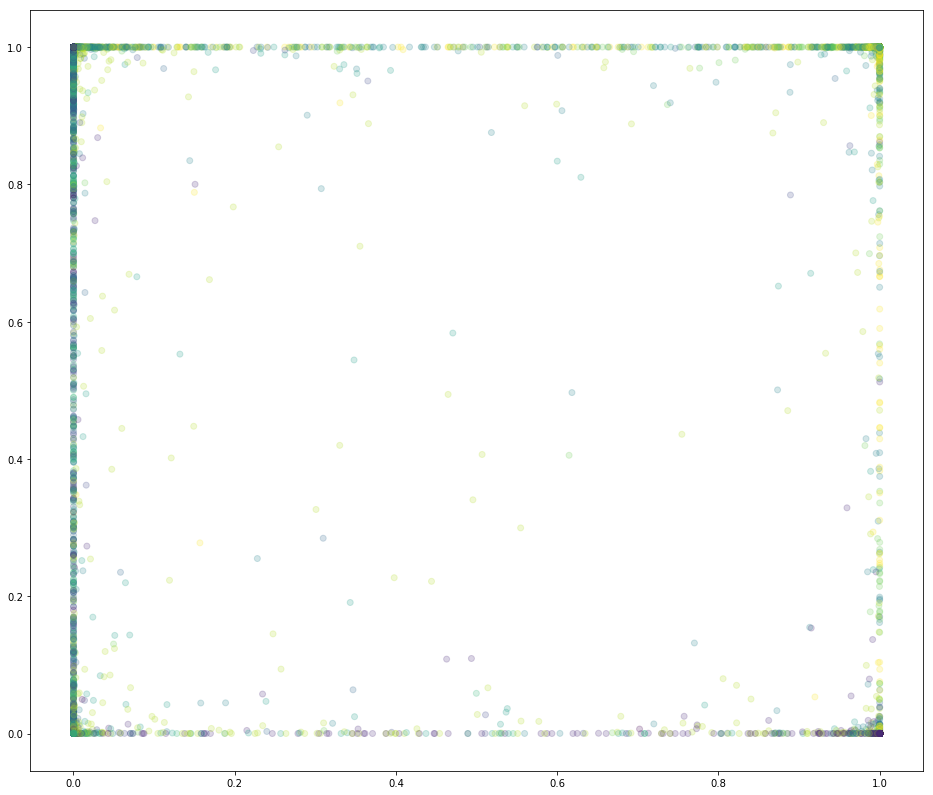

  Epoch 1 of 5 -> Cost: 168.580554813
  X: [  1.00000000e+00   2.40118869e-10   1.00000000e+00 ...,   1.00000000e+00
   1.00000000e+00   8.95408014e-09]
  Y: [  1.00000000e+00   3.80139202e-01   3.40566405e-17 ...,   9.99999762e-01
   9.93125677e-01   9.99999762e-01]


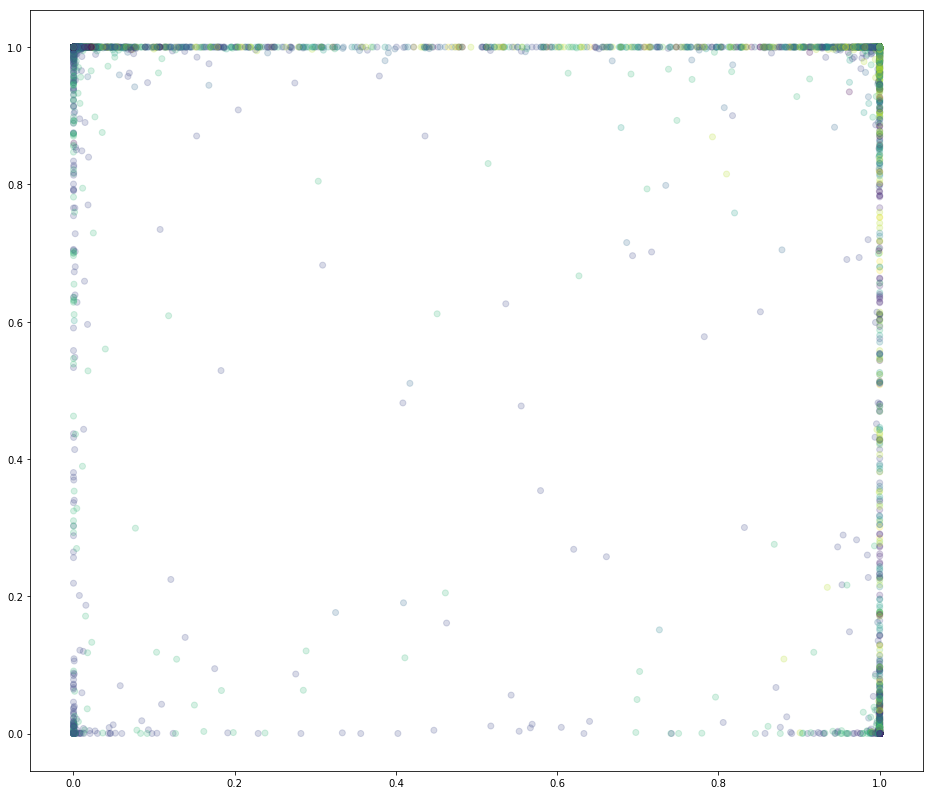

  Epoch 2 of 5 -> Cost: 141.16612339
  X: [  1.00000000e+00   3.21922244e-07   1.00000000e+00 ...,   1.00000000e+00
   1.00000000e+00   2.05925506e-04]
  Y: [  1.00000000e+00   9.46706355e-01   1.57430740e-15 ...,   9.99999881e-01
   9.99333084e-01   1.00000000e+00]


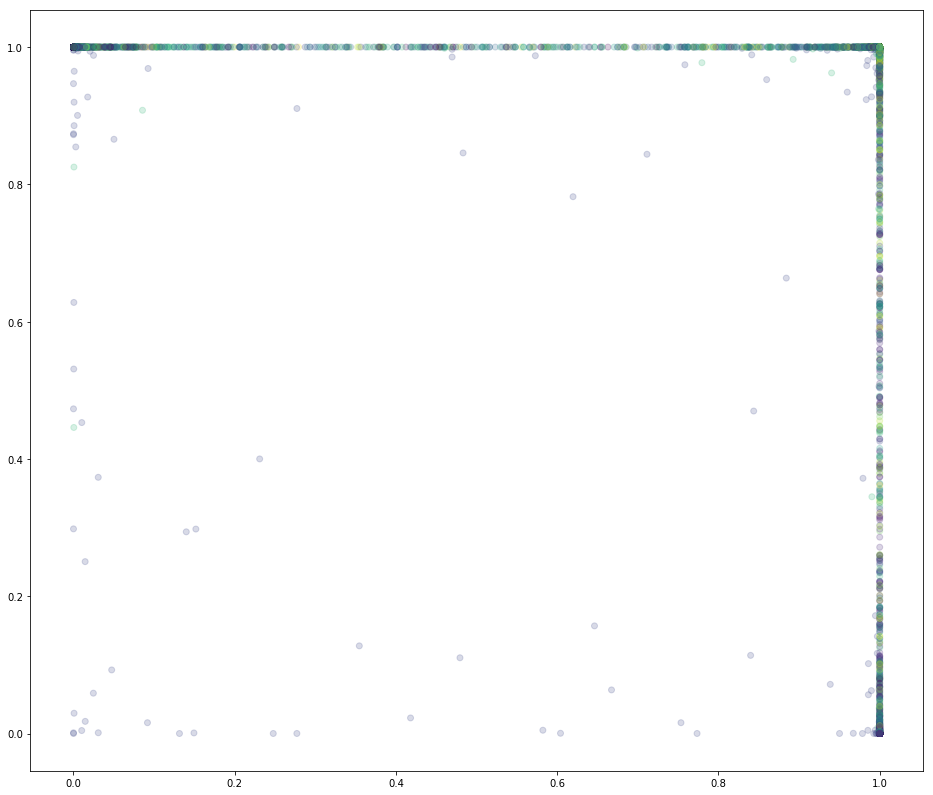

  Epoch 3 of 5 -> Cost: 137.791245446
  X: [  1.00000000e+00   1.80081543e-06   1.00000000e+00 ...,   1.00000000e+00
   1.00000000e+00   2.24366358e-05]
  Y: [  1.00000000e+00   9.63899612e-01   1.43327631e-14 ...,   9.99999046e-01
   9.95940089e-01   1.00000000e+00]


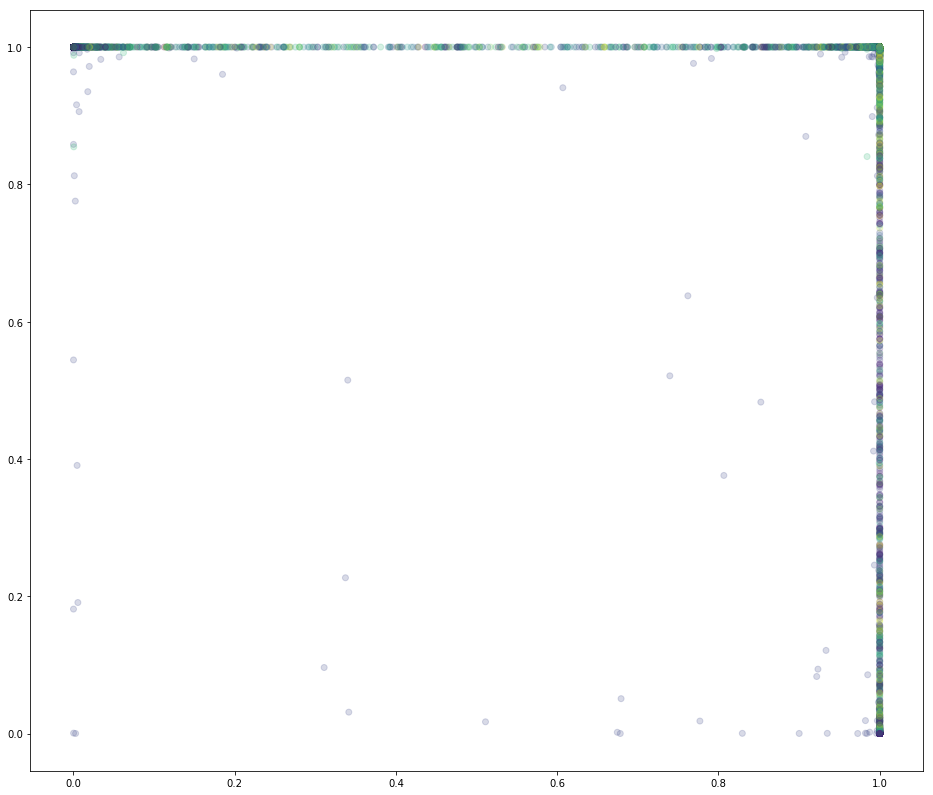

  Epoch 4 of 5 -> Cost: 136.877749547
  X: [  1.00000000e+00   8.98055587e-05   1.00000000e+00 ...,   1.00000000e+00
   1.00000000e+00   3.14209028e-04]
  Y: [  1.00000000e+00   9.41577375e-01   3.33716968e-13 ...,   9.99997139e-01
   9.84627545e-01   1.00000000e+00]


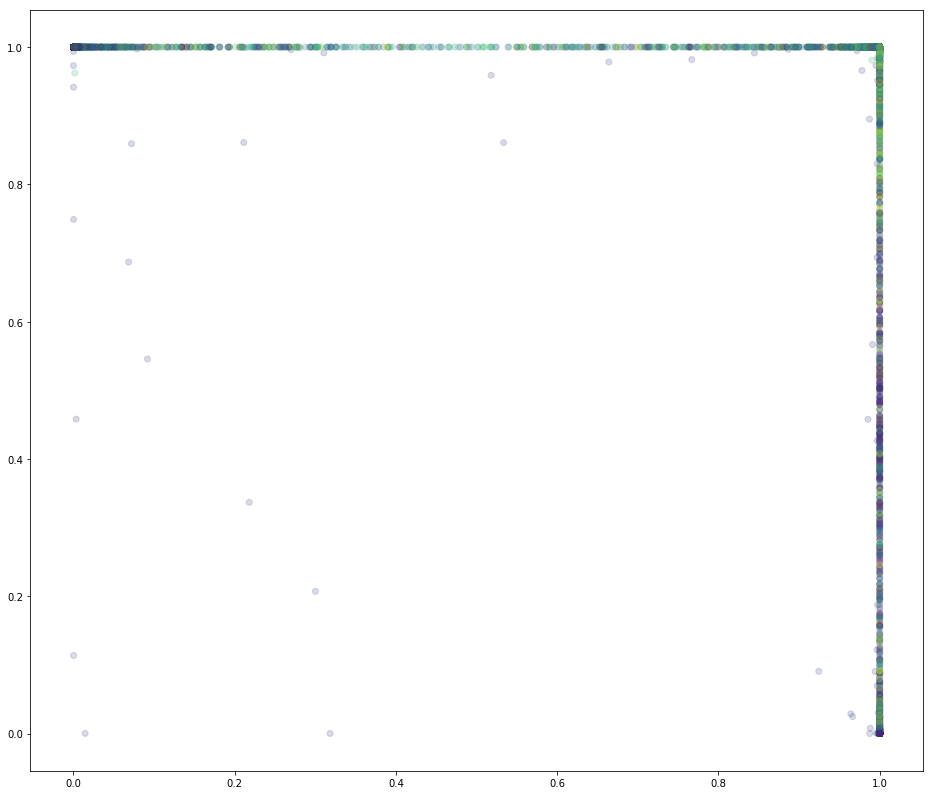

  Epoch 5 of 5 -> Cost: 136.127444759
  X: [  1.00000000e+00   7.23676174e-04   1.00000000e+00 ...,   1.00000000e+00
   1.00000000e+00   4.66152123e-04]
  Y: [  1.00000000e+00   9.34093475e-01   1.15156617e-11 ...,   9.99990940e-01
   9.71562982e-01   1.00000000e+00]


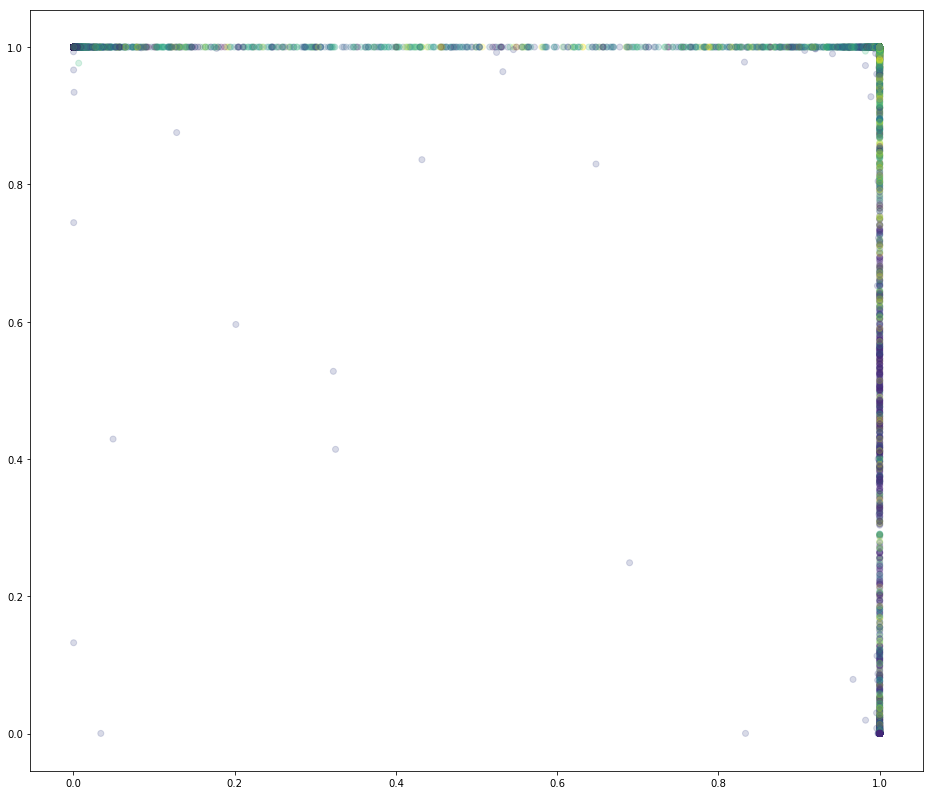

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [35]:
# Train the Autoencoder with PRE-TRAINED WEIGHTS from the RBM!

# NOTICE: Need to use the 'main_transfer' transfer method here, since the RBMs are run with that.
trainAutoencoderAndPlot(main_transfer, epochs=autoencoder_epochs, load_weights=True)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <function sigmoid at 0x7fea393daa60>

Before training:
  X: [ 0.46231684  0.46730813  0.46458748 ...,  0.46188024  0.46407291
  0.46434721]
  Y: [ 0.57649207  0.58003581  0.58001715 ...,  0.57749009  0.58001202
  0.57810122]


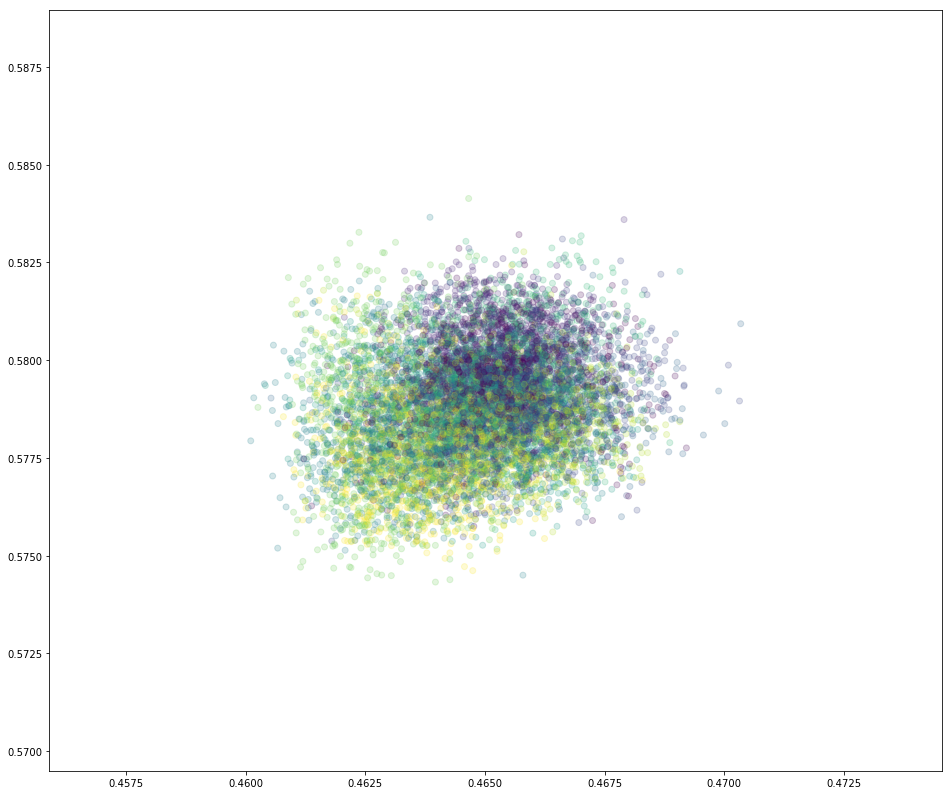

  Epoch 1 of 5 -> Cost: 147.186251327
  X: [ 0.06239597  0.06403942  0.06312925 ...,  0.0621843   0.06298245
  0.06357557]
  Y: [ 0.95086932  0.95122772  0.95163    ...,  0.95101851  0.951325    0.95035177]


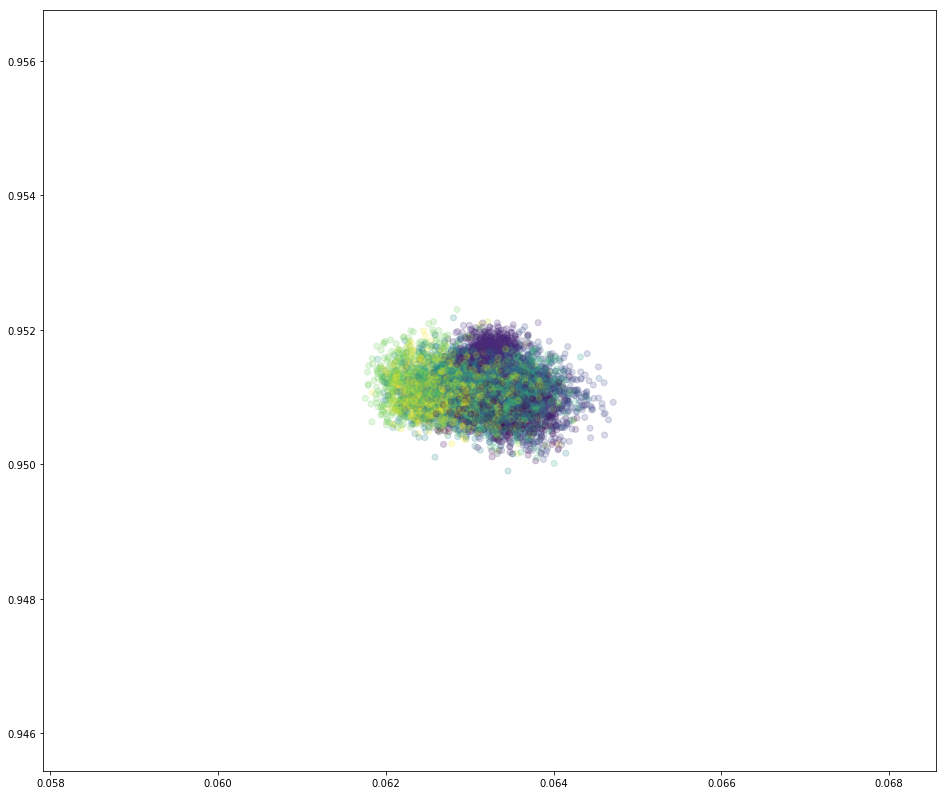

  Epoch 2 of 5 -> Cost: 142.742606983
  X: [ 0.06486051  0.06714229  0.06563207 ...,  0.06469817  0.06554473
  0.06707953]
  Y: [ 0.94326907  0.94327176  0.94450057 ...,  0.94318306  0.9436819
  0.94136161]


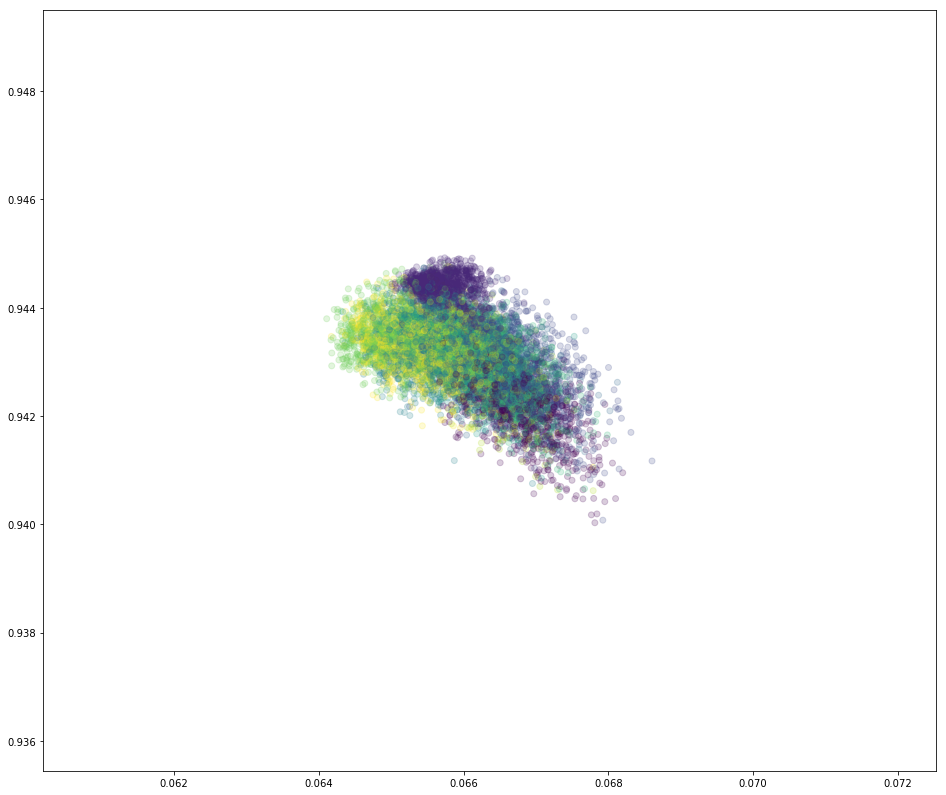

  Epoch 3 of 5 -> Cost: 142.773588732
  X: [ 0.08050778  0.08449541  0.08138236 ...,  0.08051601  0.08158631
  0.08540631]
  Y: [ 0.80432409  0.80176938  0.81045455 ...,  0.80228364  0.80499429
  0.79020077]


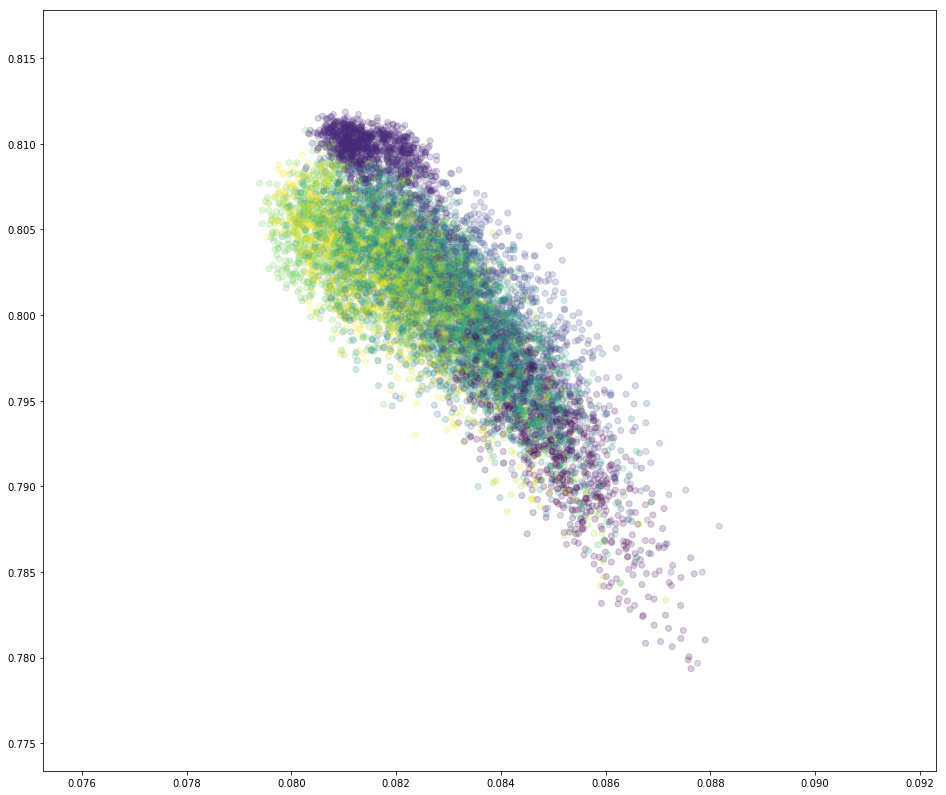

  Epoch 4 of 5 -> Cost: 142.739686131
  X: [ 0.27814463  0.3045814   0.27330133 ...,  0.28301957  0.28437862
  0.3271949 ]
  Y: [ 0.51238602  0.46284273  0.55959469 ...,  0.48683697  0.50233841
  0.36776552]


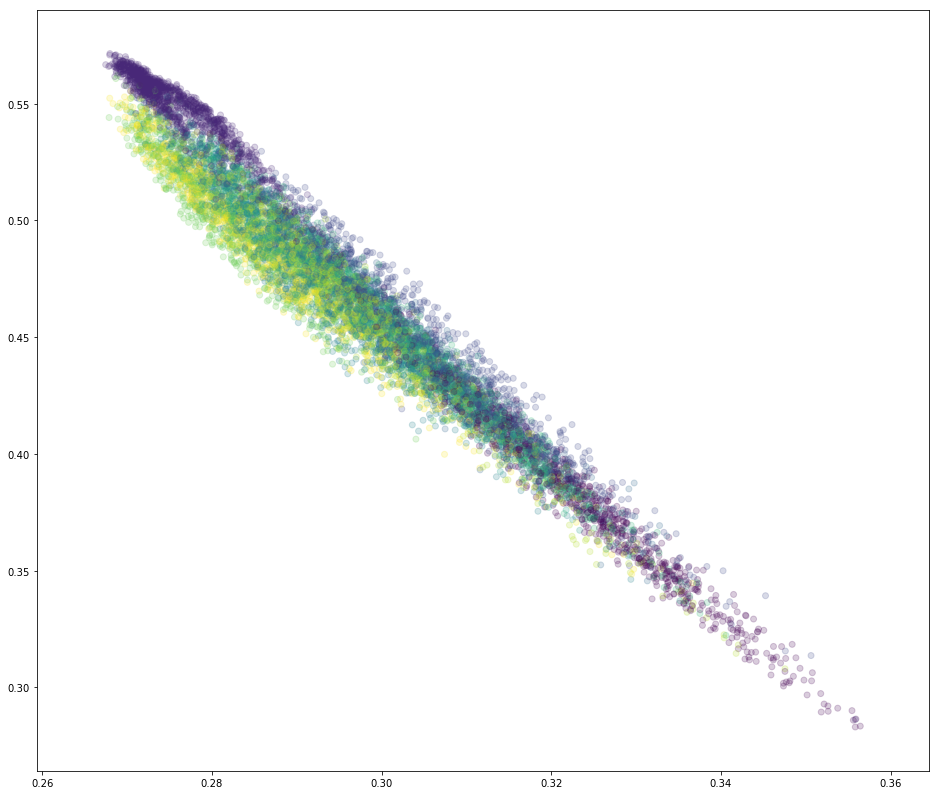

  Epoch 5 of 5 -> Cost: 142.76664342
  X: [  2.33129878e-03   9.88305330e-01   6.04383822e-04 ...,   7.48986285e-03
   2.14768331e-02   9.99280393e-01]
  Y: [  9.98580337e-01   8.38797446e-03   9.99702036e-01 ...,   9.94773567e-01
   9.84216690e-01   3.61150975e-04]


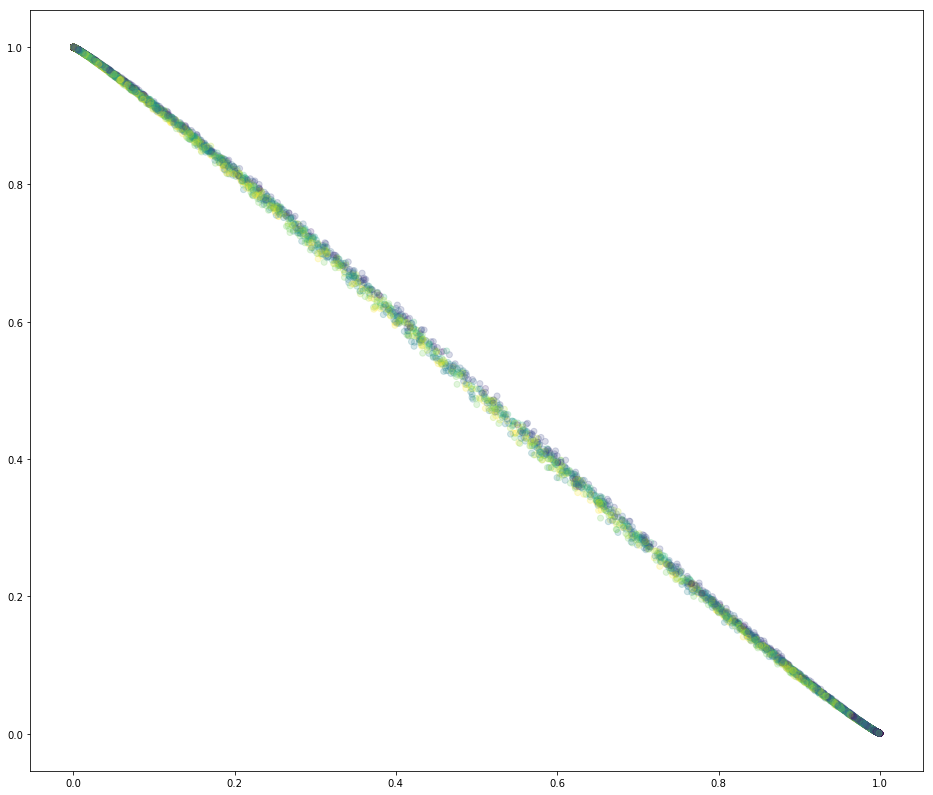

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [36]:
# Train the Autoencoder with RANDOM WEIGHTS!

# SIGMOID: Initial distribution pretty tight blob up in a corner. Often (1, 1), but also (1, 0) and (0, 0) seen.
#          There are clear observable groupings in that blob.
#          Usually collapses to one line, typically horizonal along y=0. However, also vertical. And point.

trainAutoencoderAndPlot(tf.nn.sigmoid, epochs=autoencoder_epochs)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <function relu at 0x7fea391ee8c8>

Before training:
  X: [ 0.40195358  0.07028772  0.         ...,  0.          0.02744233
  0.11177319]
  Y: [ 0.09403907  0.46065116  0.05816771 ...,  0.33124566  0.26601112
  0.29135165]


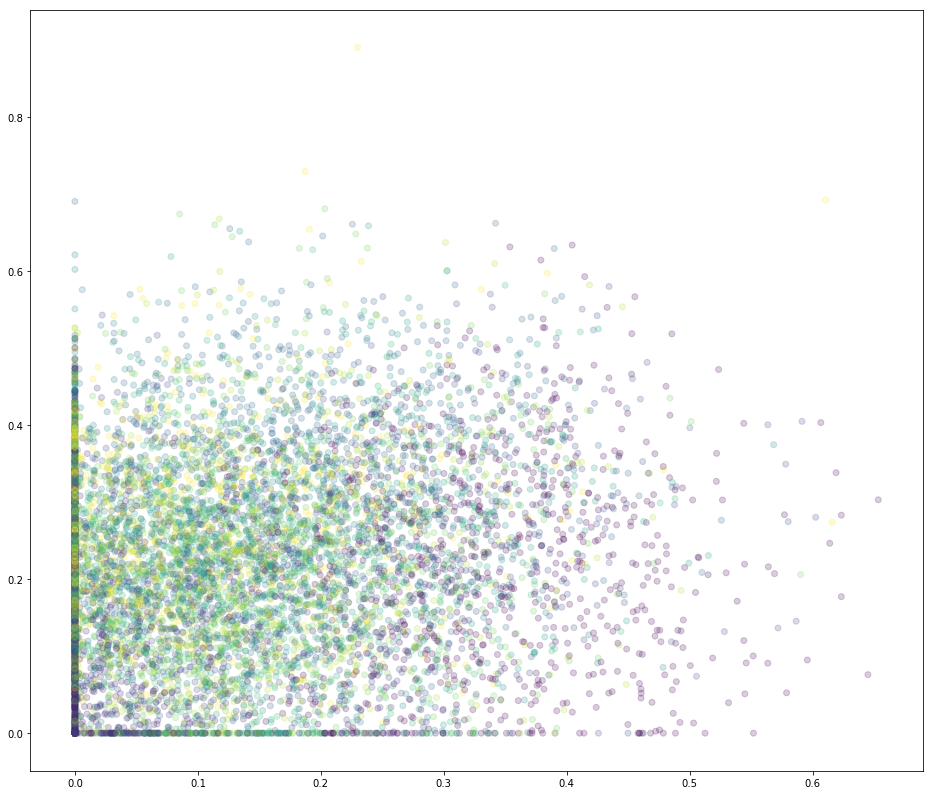

  Epoch 1 of 5 -> Cost: 143.260523632
  X: [  4.07786608   7.62960386   0.06312805 ...,   5.51125431   3.0118072
  12.73148251]
  Y: [  7.48053789   5.67502594   5.67829227 ...,  12.61837101   9.8816185
   6.71438122]


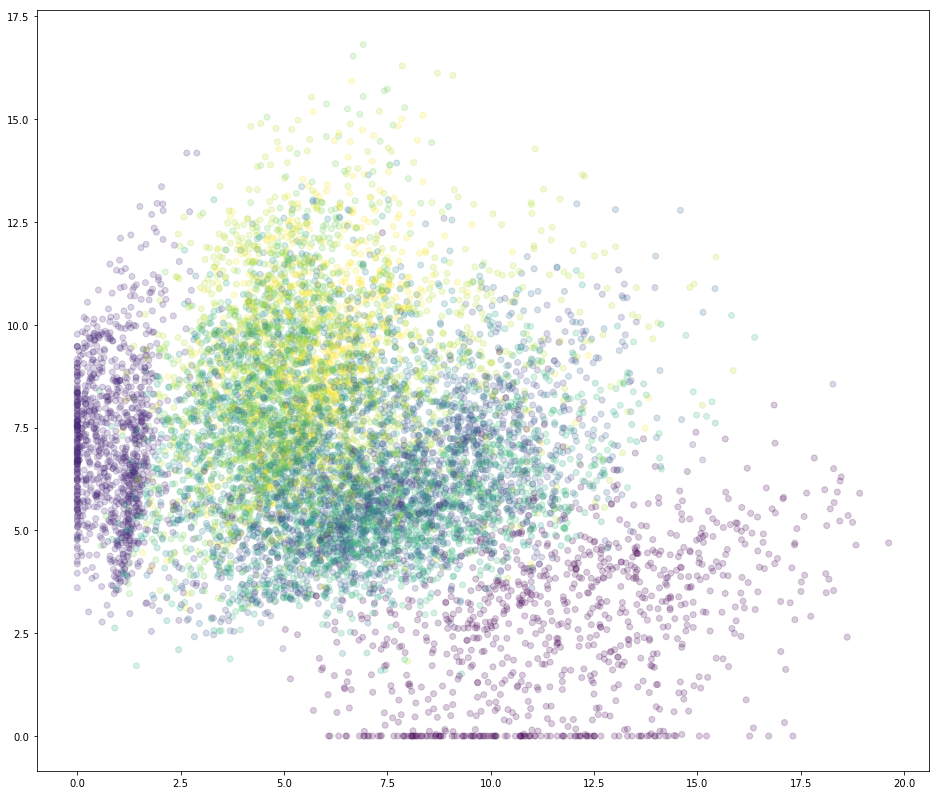

  Epoch 2 of 5 -> Cost: 132.946582735
  X: [  5.26435995   8.3506422    1.28772533 ...,   7.67107725   5.24662828
  13.98948574]
  Y: [  9.10077286   7.11809778   8.0905323  ...,  14.75756454  12.55807018
   8.33921909]


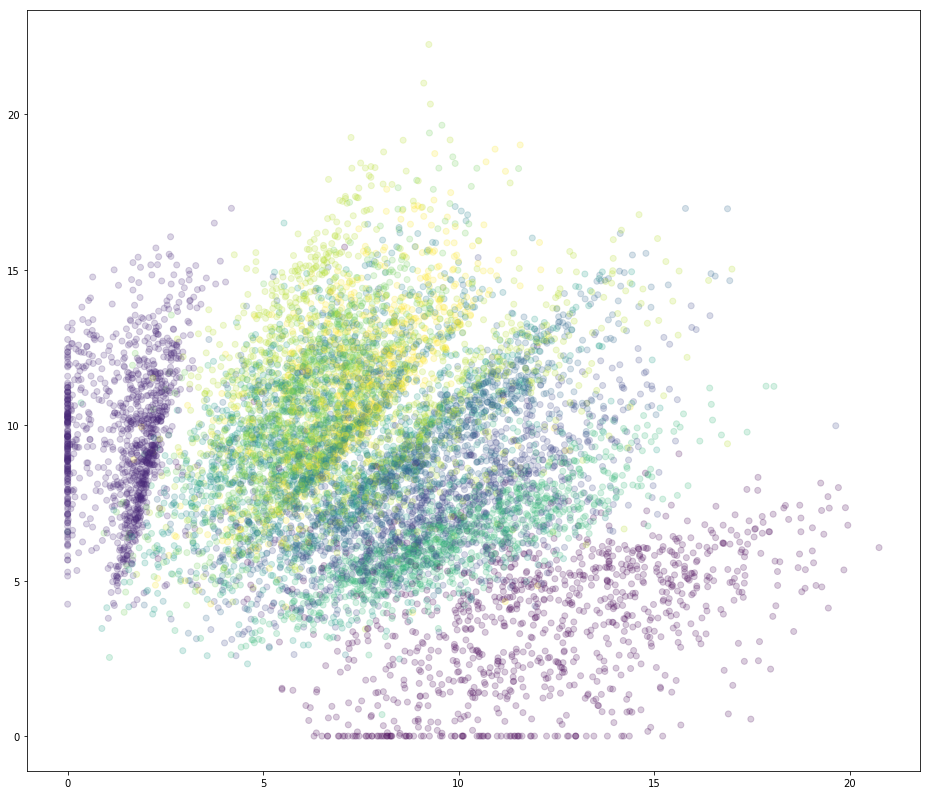

  Epoch 3 of 5 -> Cost: 128.822206035
  X: [  6.64675426   9.36139393   1.63879442 ...,   8.96928215   5.93544197
  15.86226559]
  Y: [ 10.62114811   7.73992252  11.18411255 ...,  15.90189171  13.0560112
   9.53154087]


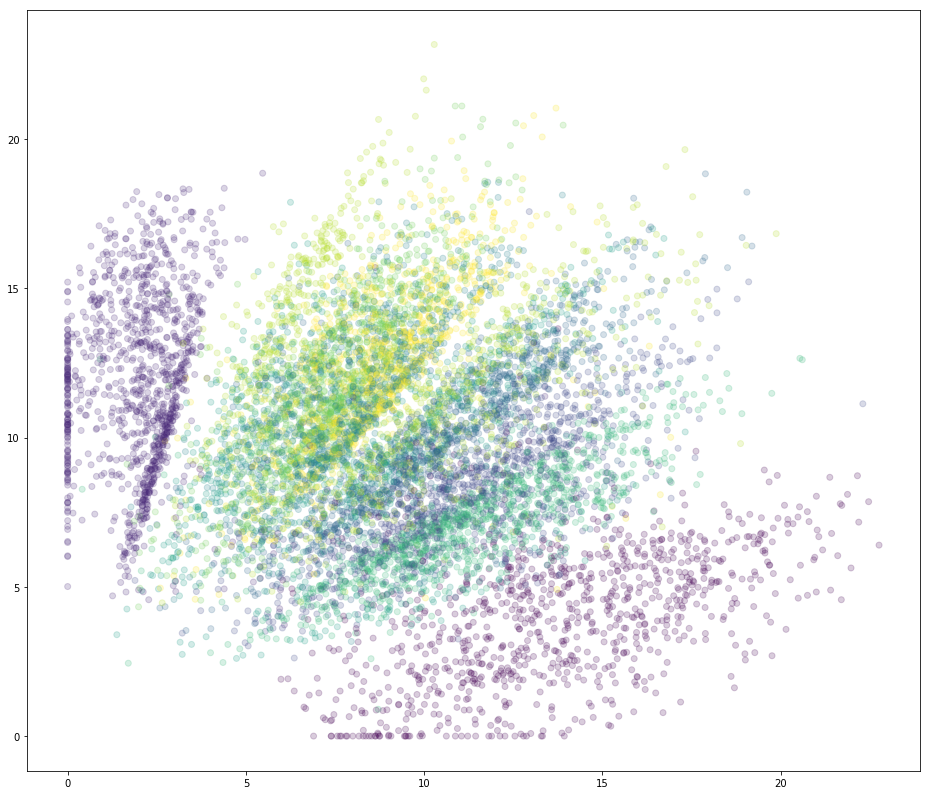

  Epoch 4 of 5 -> Cost: 125.764530391
  X: [  7.24304199   9.18852043   1.74519968 ...,   9.41403866   5.73055601
  16.2929039 ]
  Y: [ 11.54820156   7.60243368  12.29615498 ...,  16.58311081  13.45699501
   9.9724741 ]


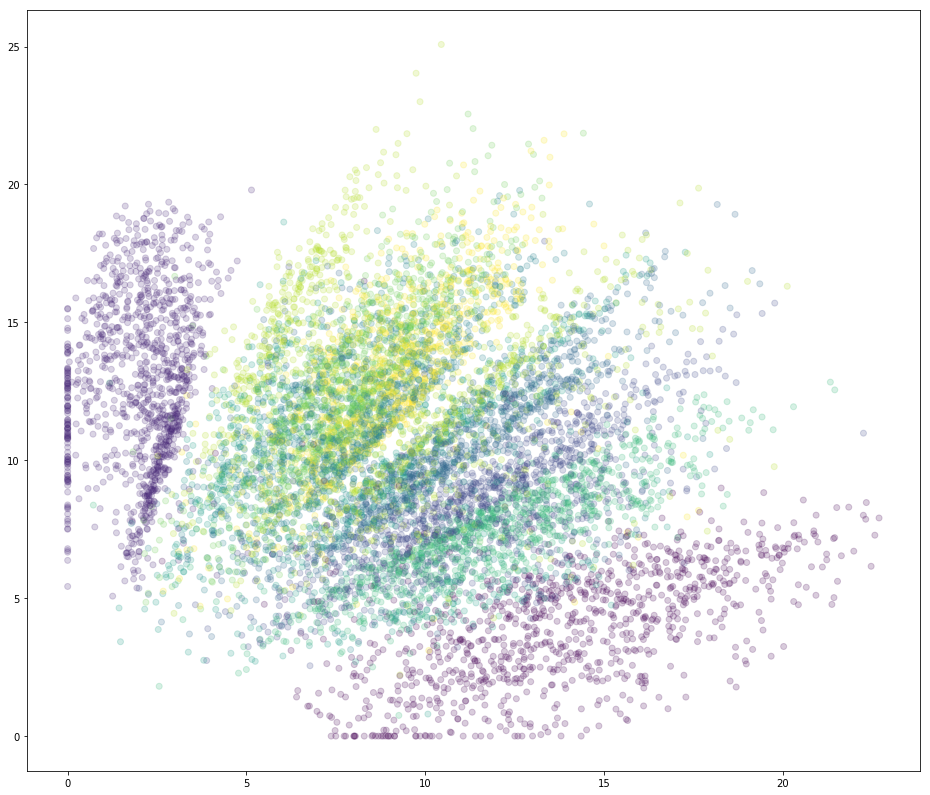

  Epoch 5 of 5 -> Cost: 123.486206338
  X: [  7.62360859   9.54789448   2.0538516  ...,   9.92846012   5.64876604
  16.75232887]
  Y: [ 11.9969101    7.9675889   12.49909687 ...,  16.89369774  12.68951511
  10.1594429 ]


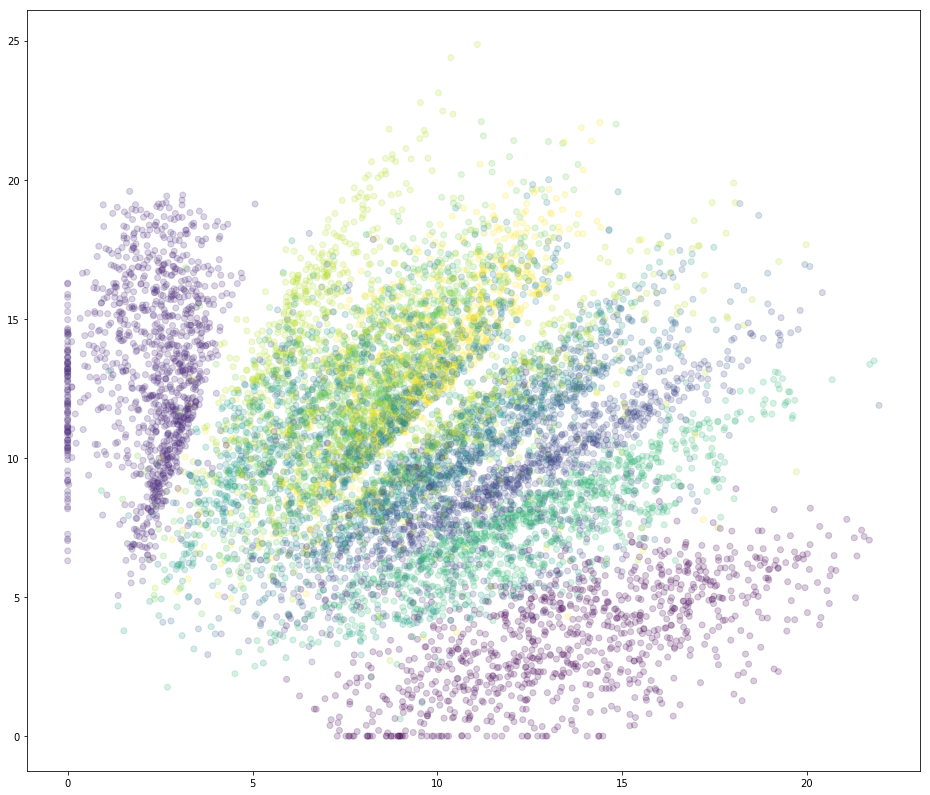

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [37]:
# Train the Autoencoder with RANDOM WEIGHTS!

# ReLU: Initial distribution is basically along both axes from (0, 0) and up to about 0.35 - more along X-axis,
#       and sometimes just a line along the X-axis with a few scattered above.
#       There are observable groupings along those lines.
#       Usually works out nicely in a "fan"-groups from origo, but observed collapse to vertical line along y=0

trainAutoencoderAndPlot(tf.nn.relu, epochs=autoencoder_epochs)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <keras.layers.advanced_activations.LeakyReLU object at 0x7fea1c668400>

Before training:
  X: [ 0.37743485  0.06382119  0.02944513 ...,  0.21417904 -0.0208858
  0.11037805]
  Y: [ 0.16883974 -0.07904646  0.13659519 ...,  0.24961364 -0.00068054
 -0.0618376 ]


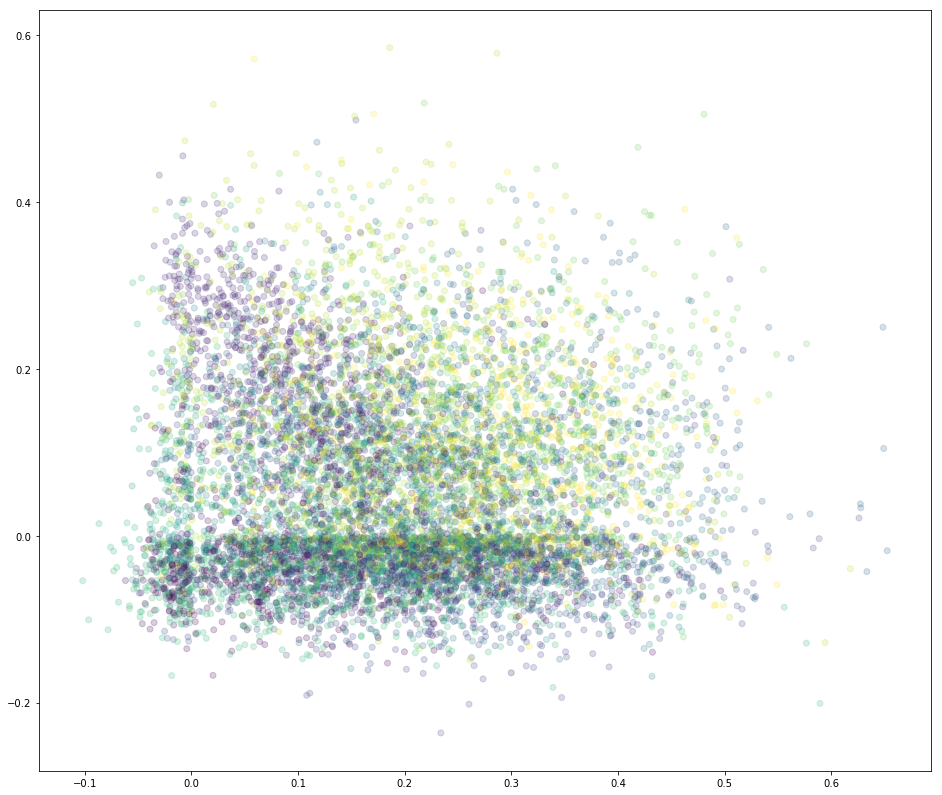

  Epoch 1 of 5 -> Cost: 130.410290718
  X: [ 3.65571022  3.10761762 -0.28680563 ...,  5.51392651  3.17241478
  6.56270742]
  Y: [ 3.42344403 -0.19543599  7.05992651 ...,  5.14673471  7.11746073
 -0.87177092]


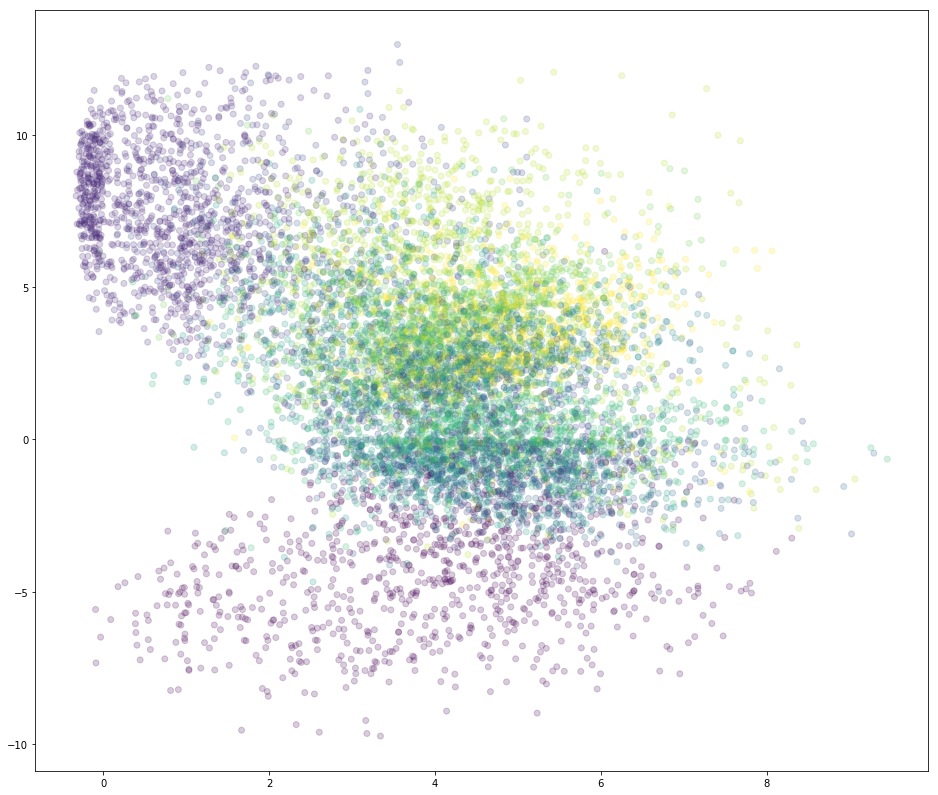

  Epoch 2 of 5 -> Cost: 124.142861009
  X: [ 4.70125389  2.62157583 -0.76237452 ...,  6.15833998  3.81091404
  7.44254589]
  Y: [ 4.0360508   1.80653274  5.90092134 ...,  6.35068989  6.30261755
  1.67090476]


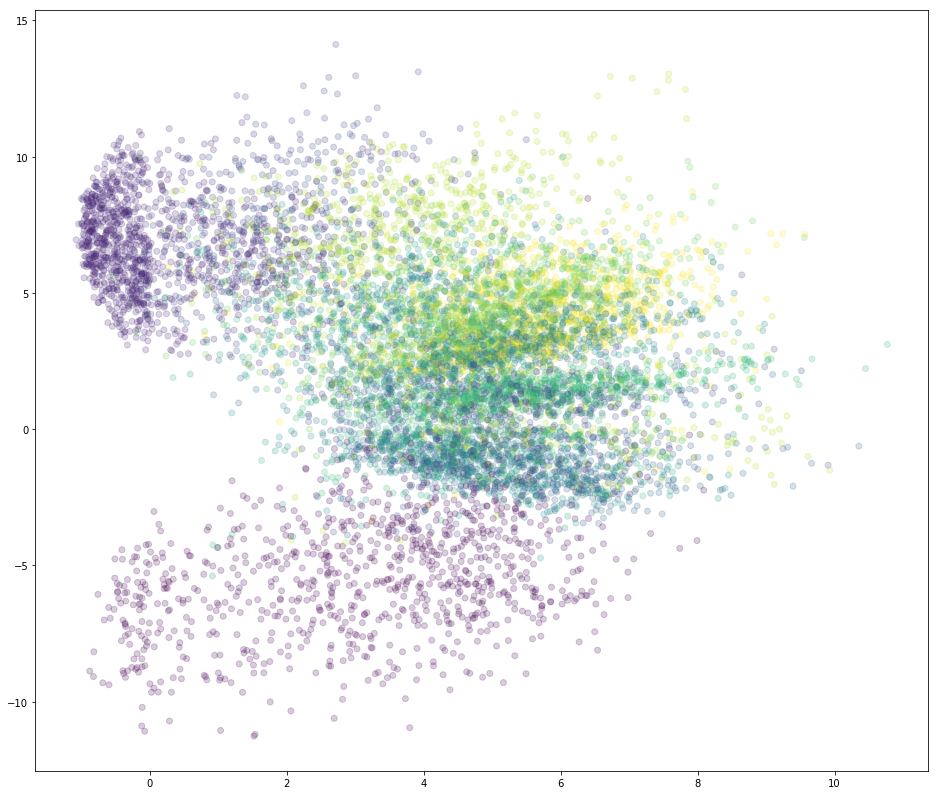

  Epoch 3 of 5 -> Cost: 121.546412736
  X: [ 4.58815527  3.31722617 -0.82373422 ...,  5.86613846  3.59758067
  7.66454077]
  Y: [ 4.08381796 -0.33213294  3.9107132  ...,  6.46451616  4.82830763
  1.54583025]


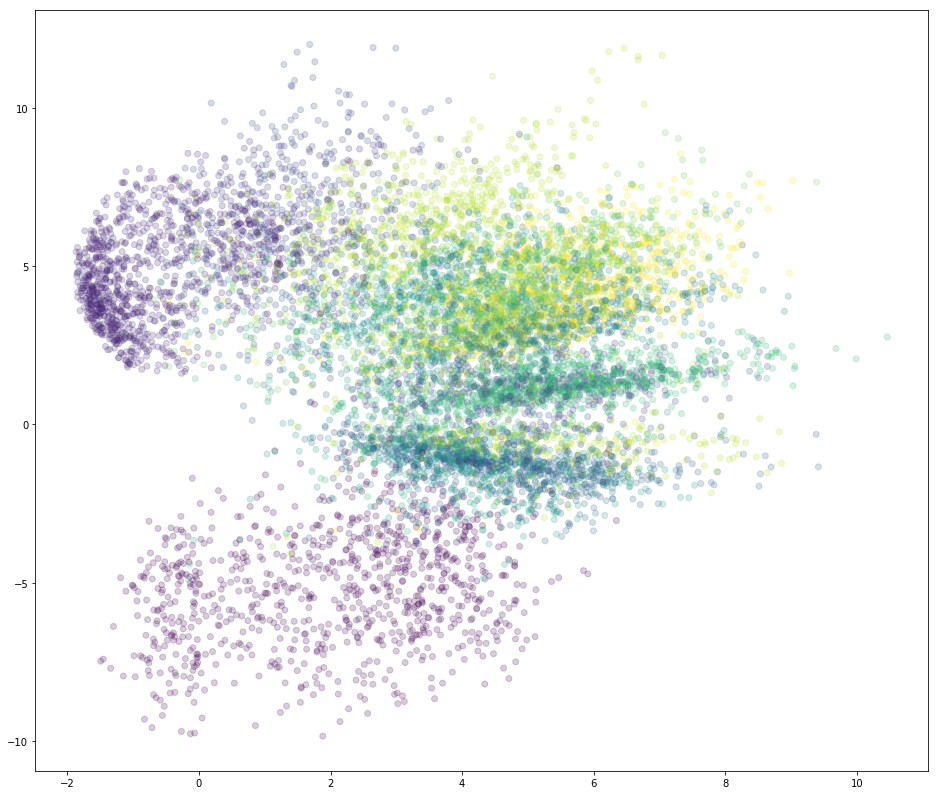

  Epoch 4 of 5 -> Cost: 119.701063454
  X: [ 5.04706192  3.10006332 -0.72893476 ...,  5.81602383  3.29883027
  7.48165274]
  Y: [ 4.31710815 -0.23726943  4.65432978 ...,  6.0457387   4.23950672
  1.15676236]


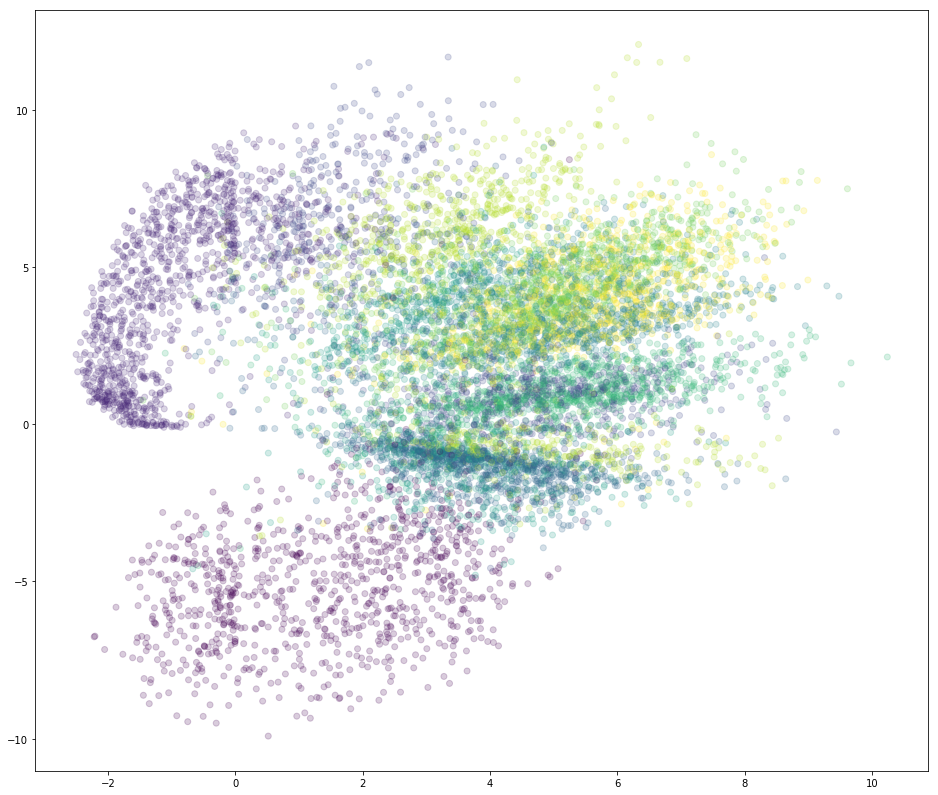

  Epoch 5 of 5 -> Cost: 118.407865718
  X: [ 5.56042862  3.19832063 -1.05459881 ...,  5.48578262  2.74939704
  7.68382359]
  Y: [ 4.85514355 -0.14032726  4.5867548  ...,  6.0344696   3.60512471
  1.19602835]


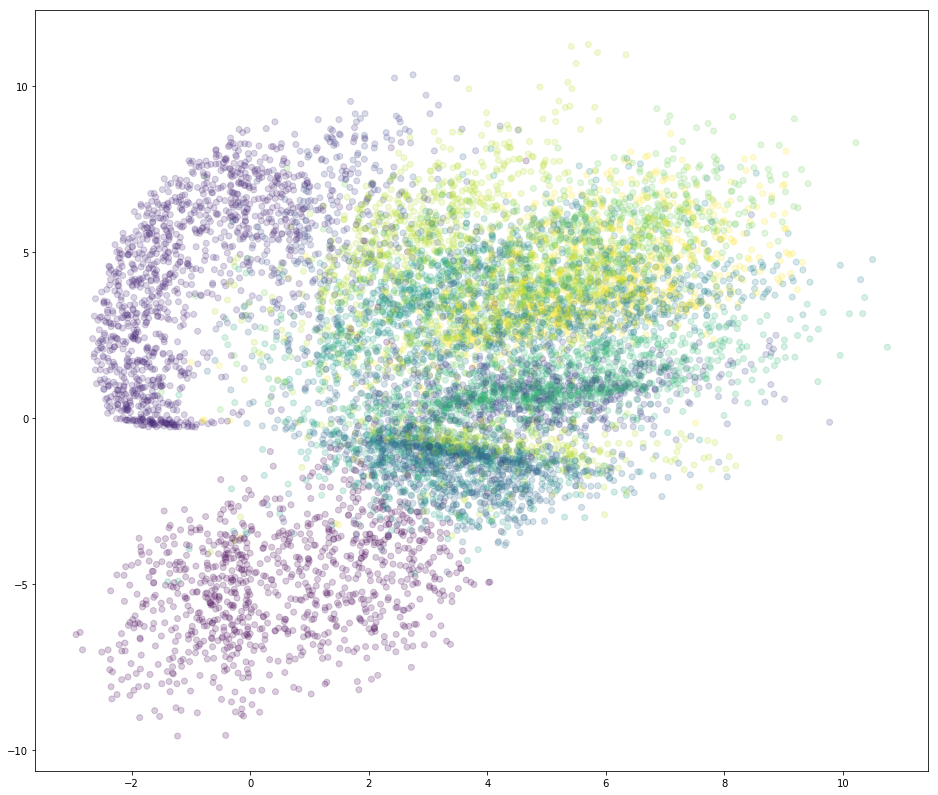

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [38]:
# Train the Autoencoder with RANDOM WEIGHTS!

# LeakyReLU: Initial distribution makes a cool "cross"
#       There are clear observable groupings.
#       Usually works out nicely in a "fan"-groups from origo, in all directions

from keras.layers.advanced_activations import LeakyReLU

trainAutoencoderAndPlot(LeakyReLU(alpha=0.3), epochs=autoencoder_epochs)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <function elu at 0x7fea391d98c8>

Before training:
  X: [-0.42006135 -0.43726063  0.01869946 ..., -0.62408078 -0.3059274
 -0.67489052]
  Y: [-0.02107495  0.45793644  0.67308581 ..., -0.18158376  0.41257602
 -0.17012501]


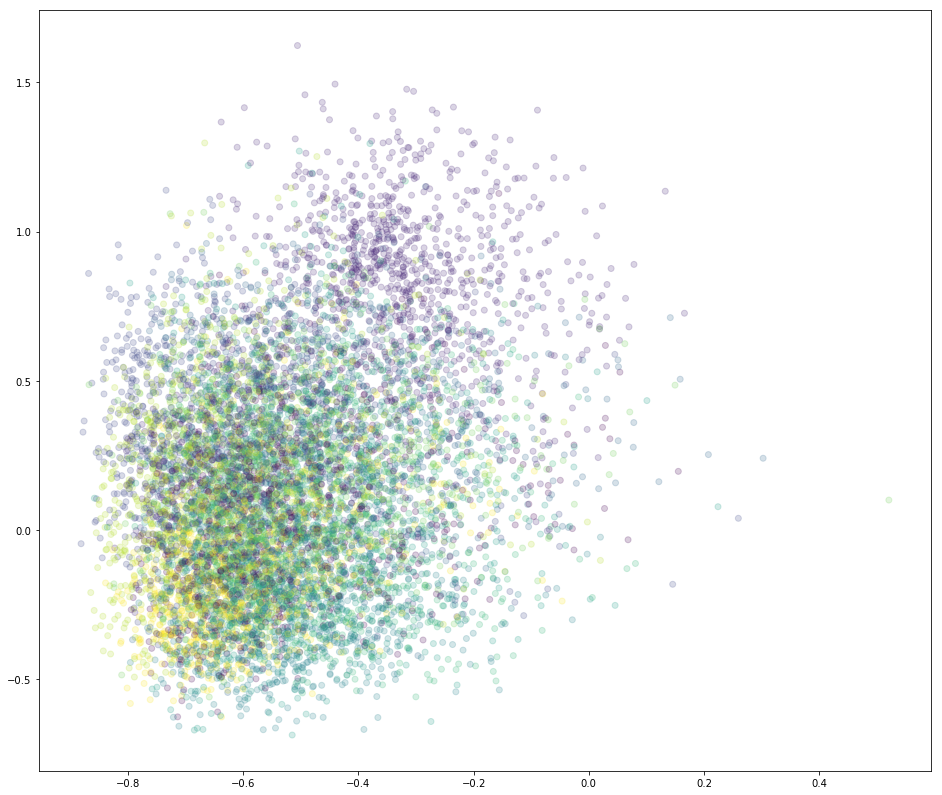

  Epoch 1 of 5 -> Cost: 135.126160011
  X: [-0.27169359 -0.32454425 -0.22303796 ..., -0.6706847  -0.52436173
 -0.56064737]
  Y: [ 0.13918935 -0.04491973  0.48138896 ...,  0.45298541  0.29055732
 -0.51455963]


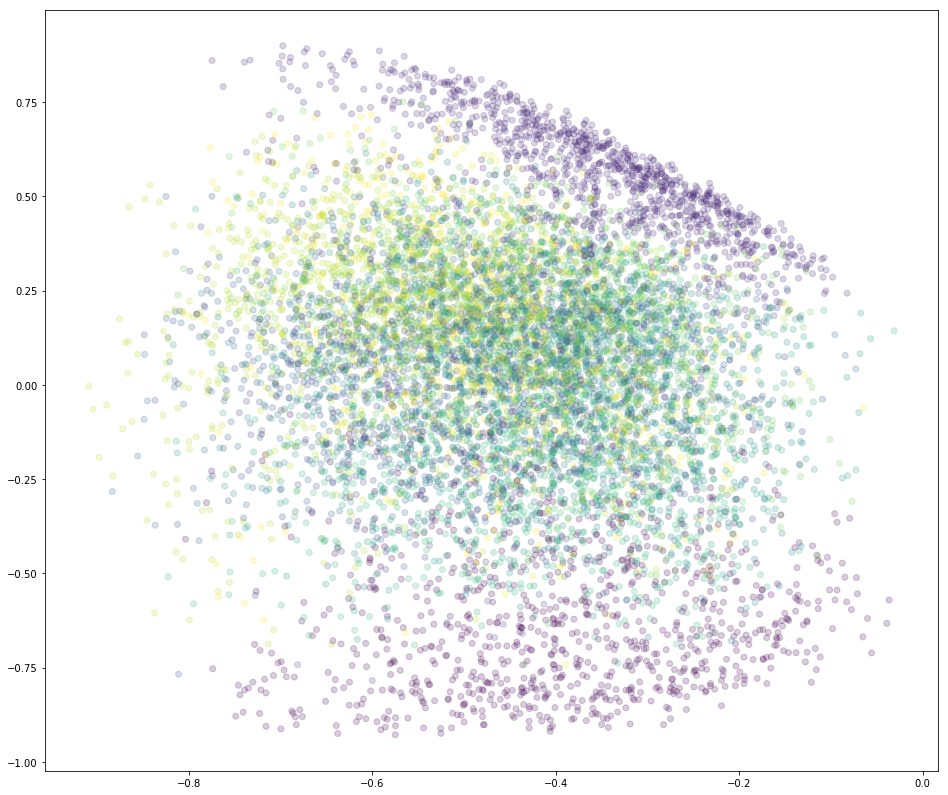

  Epoch 2 of 5 -> Cost: 130.003692955
  X: [-0.19995242 -0.56069863 -0.25640655 ..., -0.48942512 -0.53283823
 -0.58915555]
  Y: [ 0.28736404  0.95722675  1.49670291 ...,  0.44480085  0.9384582
 -0.43586618]


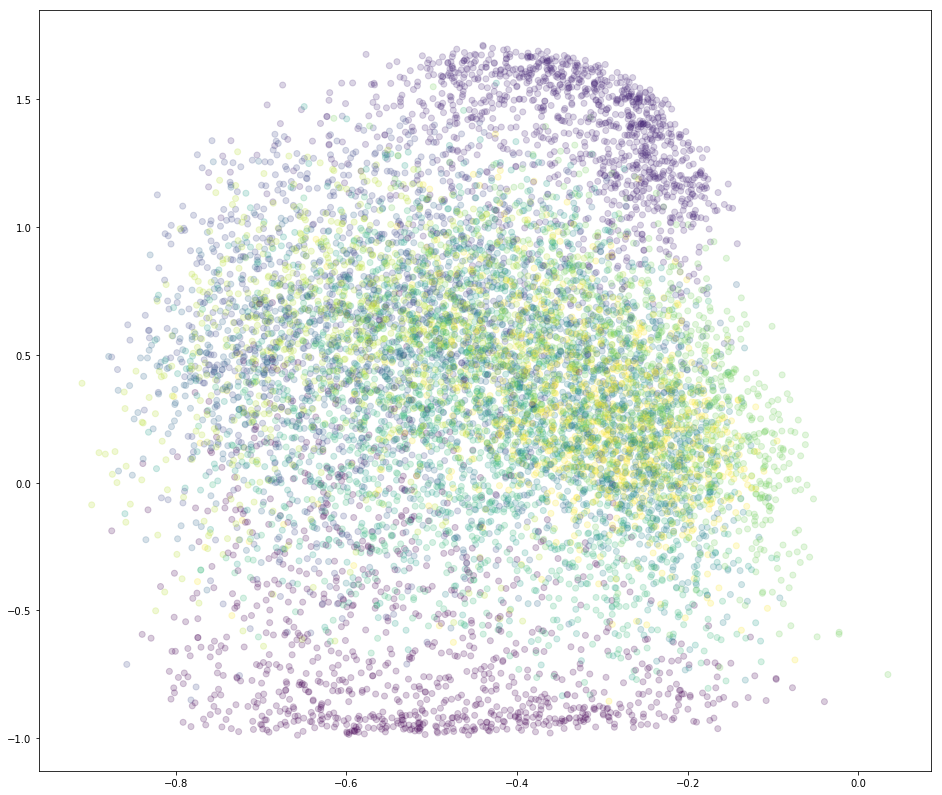

  Epoch 3 of 5 -> Cost: 128.340038985
  X: [-0.0788027  -0.69211888 -0.20136273 ..., -0.30768657 -0.4310739
 -0.63874292]
  Y: [ 0.24789578  0.94460225  1.50160944 ...,  0.28411719  0.71804529
 -0.37446749]


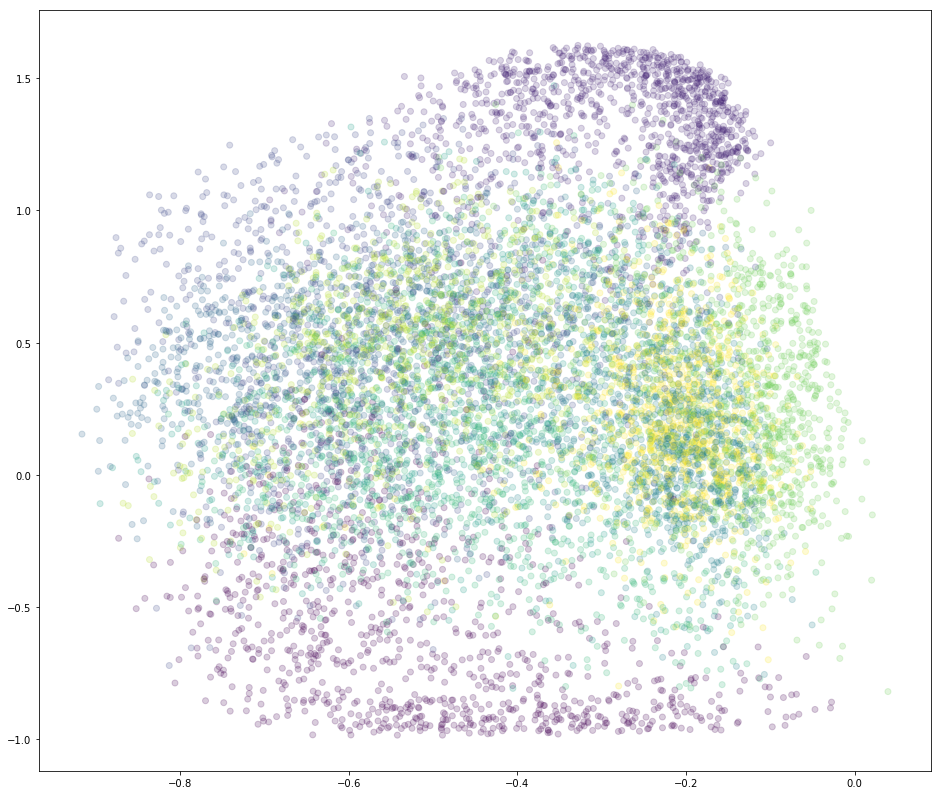

  Epoch 4 of 5 -> Cost: 127.525011197
  X: [ 0.21164502 -0.61968058  0.15299709 ..., -0.14921033 -0.14533061
 -0.6737476 ]
  Y: [ 0.43020597  1.59658194  2.11211944 ...,  0.46816003  1.14821935
 -0.40093213]


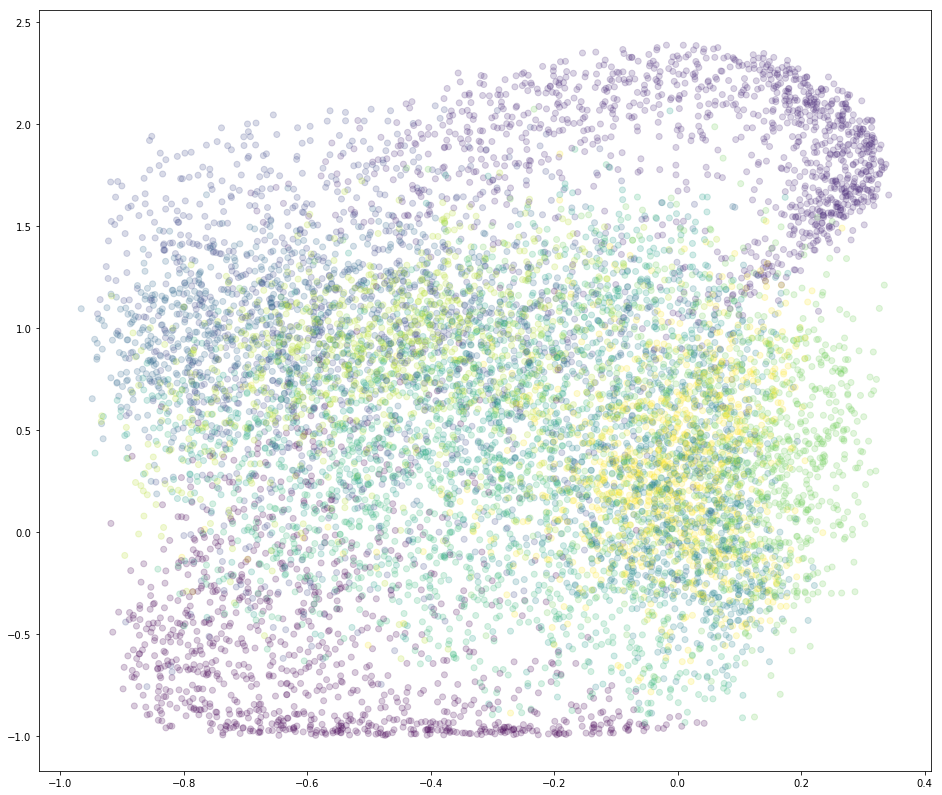

  Epoch 5 of 5 -> Cost: 125.60602808
  X: [ 1.10527825 -0.38877845  0.89346951 ...,  0.23580325  0.44025058
 -0.52923286]
  Y: [ 0.45439208  1.23368406  2.53264737 ...,  0.37439212  0.95613915
 -0.19529039]


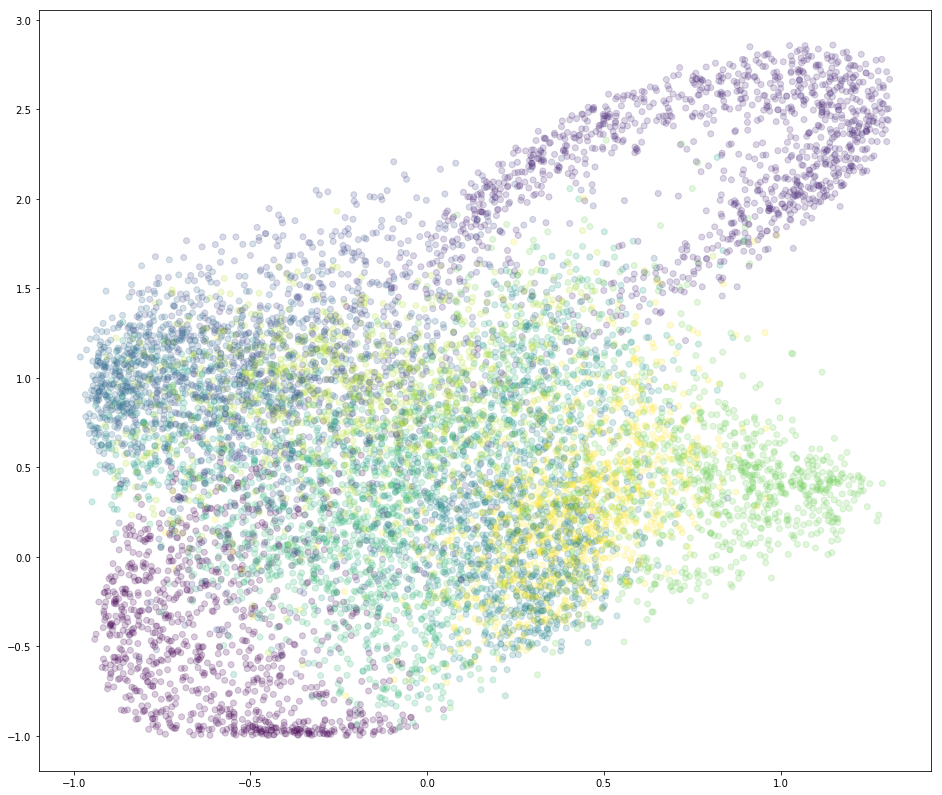

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [39]:
# Train the Autoencoder with RANDOM WEIGHTS!

# ELU: Initial distribution is a blob around origo, but more on the positive side than negative.
#      There are observable groupings.
#      Strangely, training moves the blob with a quite hard "cutoff" at y~=-1 and x~=-1.
#      Also observed collapse to point at (-1, -1)

trainAutoencoderAndPlot(tf.nn.elu, epochs=autoencoder_epochs)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <function softsign at 0x7fea391ca0d0>

Before training:
  X: [ 0.21440351 -0.00811258  0.17425528 ...,  0.18425851  0.2316661
  0.18870711]
  Y: [-0.11417788  0.02469941 -0.00364827 ...,  0.04934556 -0.14457645
  0.14987114]


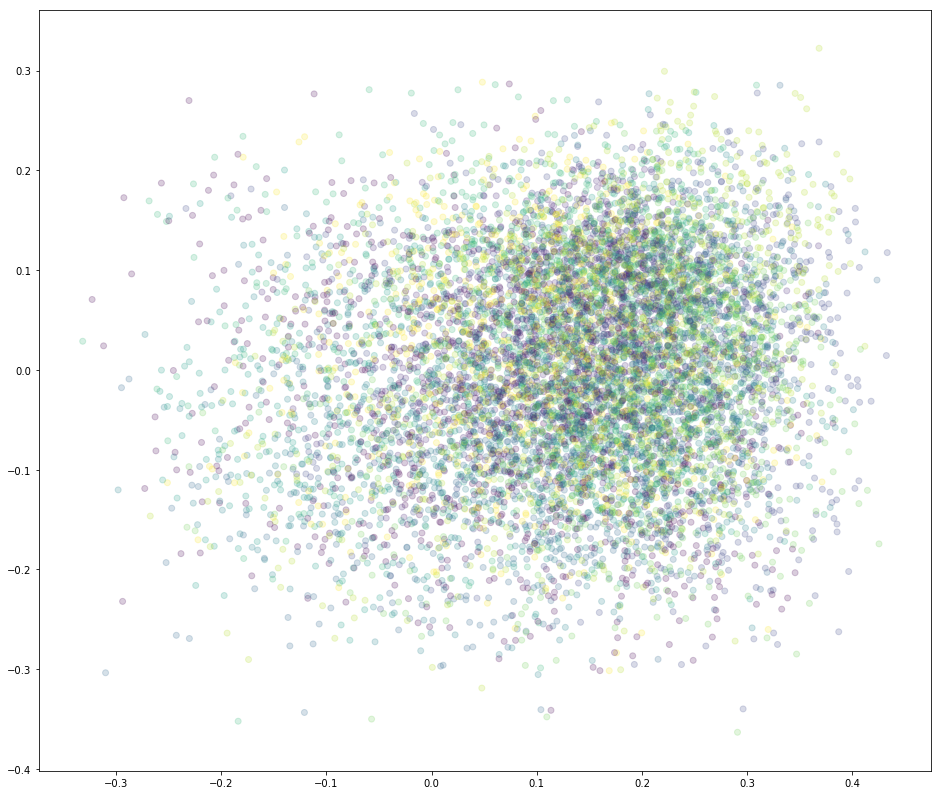

  Epoch 1 of 5 -> Cost: 137.857618868
  X: [-0.26889279 -0.28692052 -0.65611583 ..., -0.44147295 -0.50057459
  0.3338595 ]
  Y: [ 0.1799987   0.33818874  0.36889669 ...,  0.54695988  0.49538201
  0.31958121]


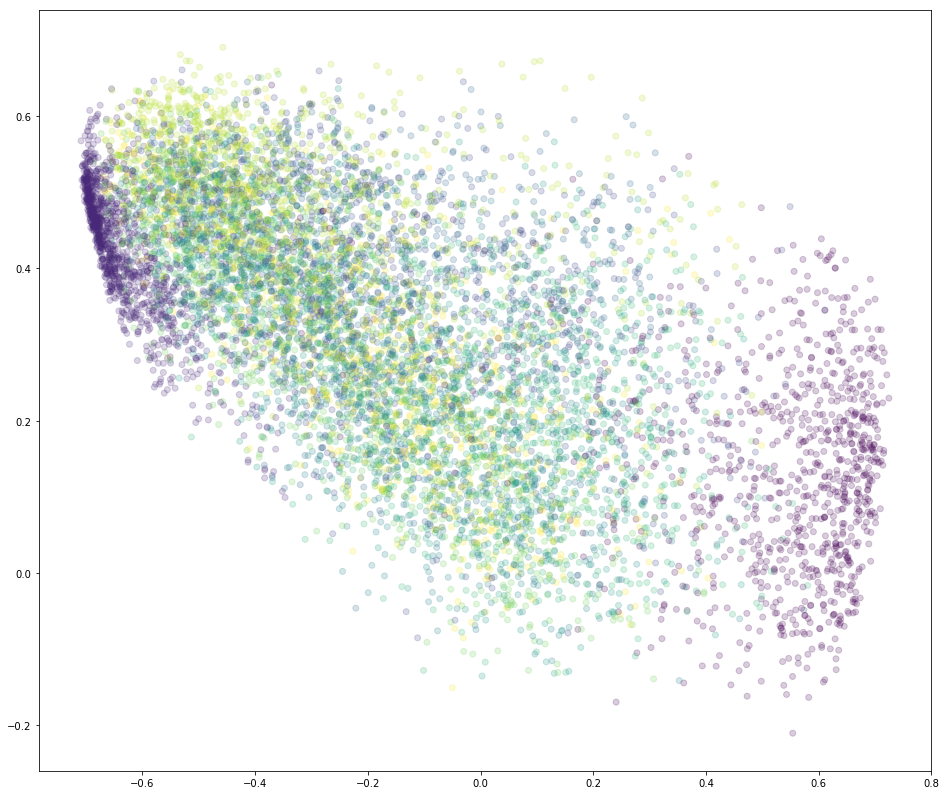

  Epoch 2 of 5 -> Cost: 131.808047578
  X: [-0.25532219 -0.37792301 -0.66340393 ..., -0.27866146 -0.4601517
  0.32766658]
  Y: [ 0.11039747  0.46470866  0.41104054 ...,  0.23571034  0.47541726
  0.33295617]


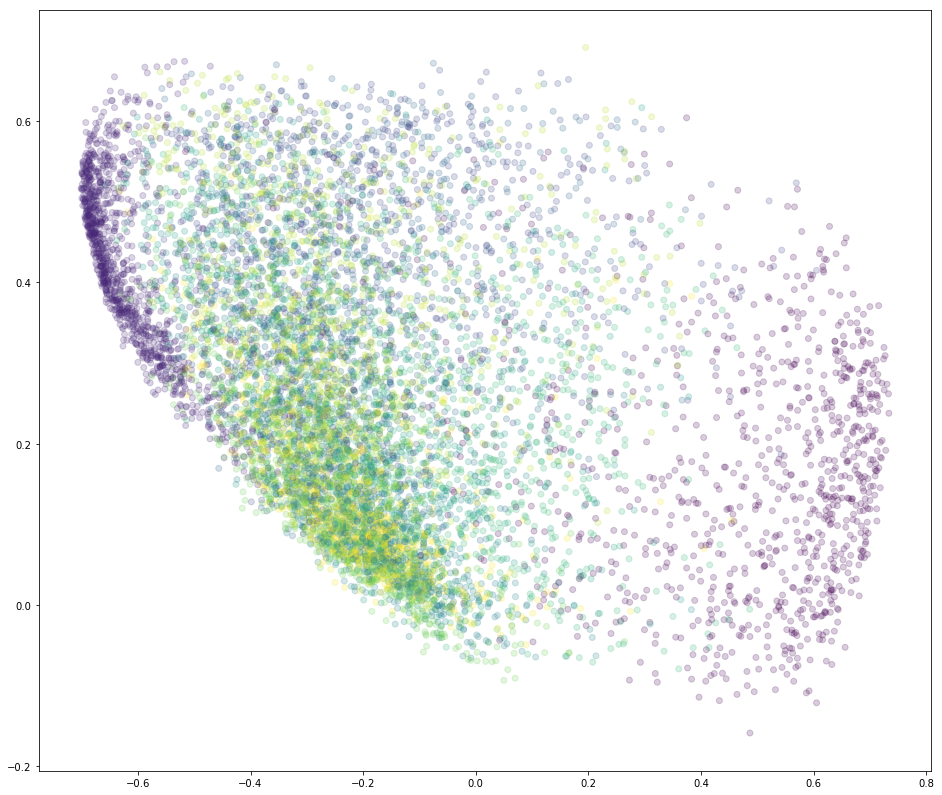

  Epoch 3 of 5 -> Cost: 128.968096033
  X: [-0.31082201 -0.41398716 -0.71395314 ..., -0.24325638 -0.41966391
  0.29000339]
  Y: [ 0.06911106  0.6259591   0.53209478 ...,  0.1235114   0.42850801
  0.22958146]


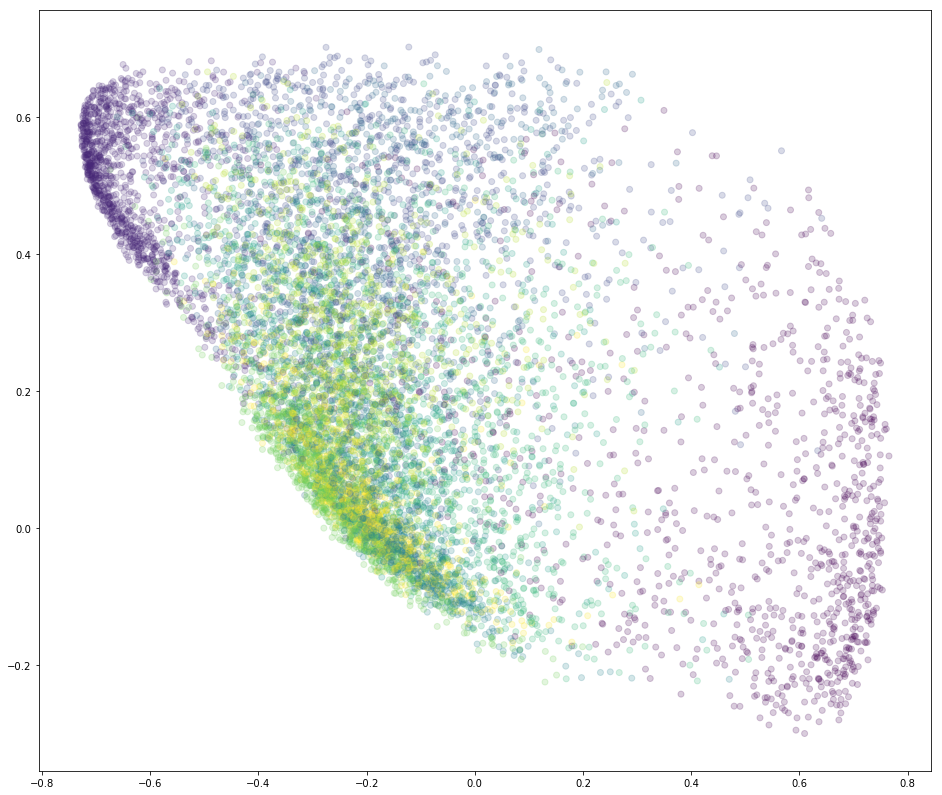

  Epoch 4 of 5 -> Cost: 127.261817694
  X: [-0.39055753 -0.25990832 -0.7229231  ..., -0.30003342 -0.41428718
  0.28449196]
  Y: [-0.13823573  0.63750243  0.54734951 ...,  0.01019765  0.33045542
  0.22217998]


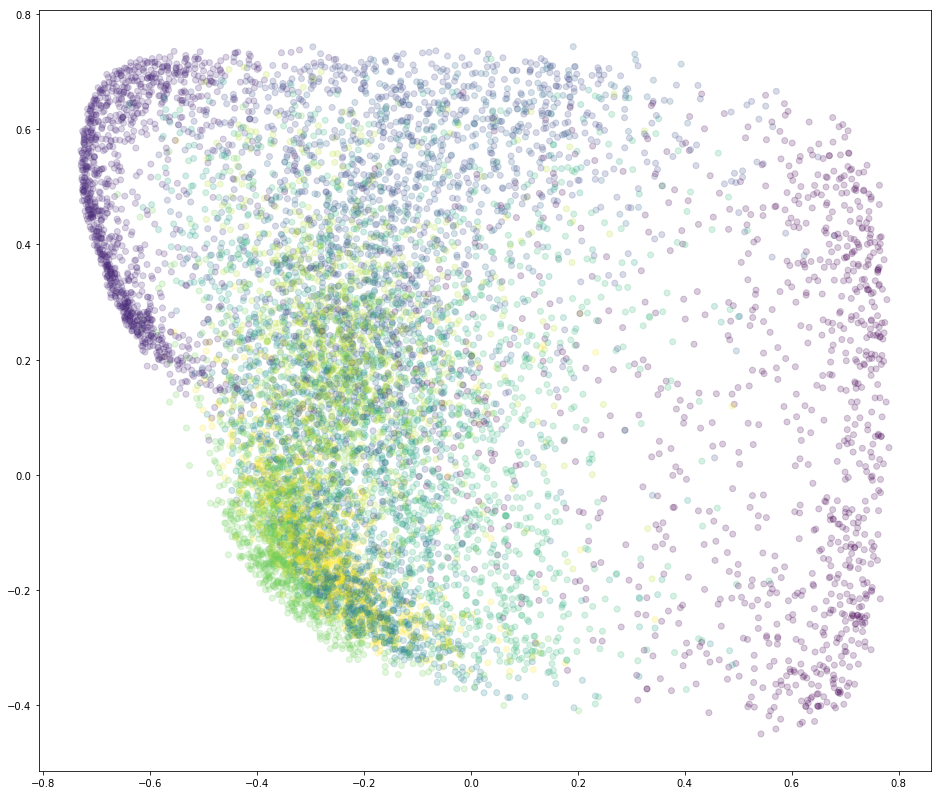

  Epoch 5 of 5 -> Cost: 124.856642842
  X: [-0.52468967 -0.17250371 -0.72608238 ..., -0.34121126 -0.46361116
  0.20351678]
  Y: [-0.3463437   0.46473378  0.53731394 ..., -0.10863046  0.14359875
  0.13269421]


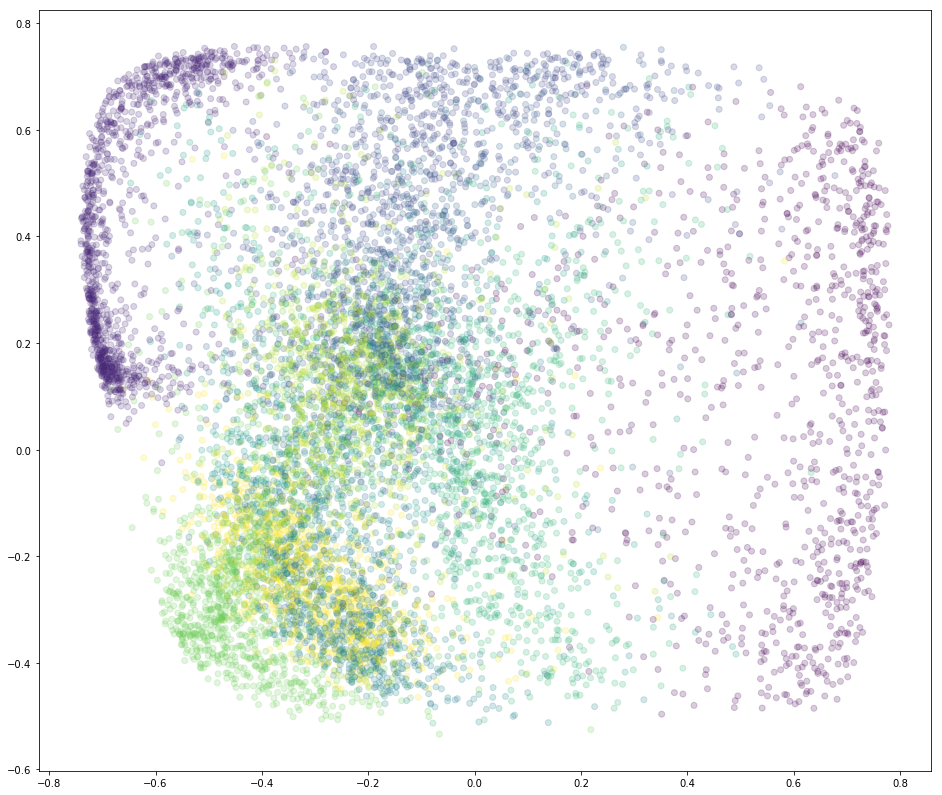

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [40]:
# Train the Autoencoder with RANDOM WEIGHTS!

# SOFTSIGN: Initial distribution is a quite nice, but asymmetric blob. Already observable group tendencies.
#           Seems to always give some nice group separations, never observed collapse

trainAutoencoderAndPlot(tf.nn.softsign, epochs=autoencoder_epochs)

# Training Autoencoder with RANDOM initialization of weights.
  Epochs: 5
  Transfer function: <function tanh at 0x7fea393daae8>

Before training:
  X: [-0.4885489   0.16350089 -0.11745603 ..., -0.57419187  0.18059775
 -0.08739412]
  Y: [ 0.15402853 -0.09274022 -0.16218151 ..., -0.00394452 -0.25086537
  0.4885473 ]


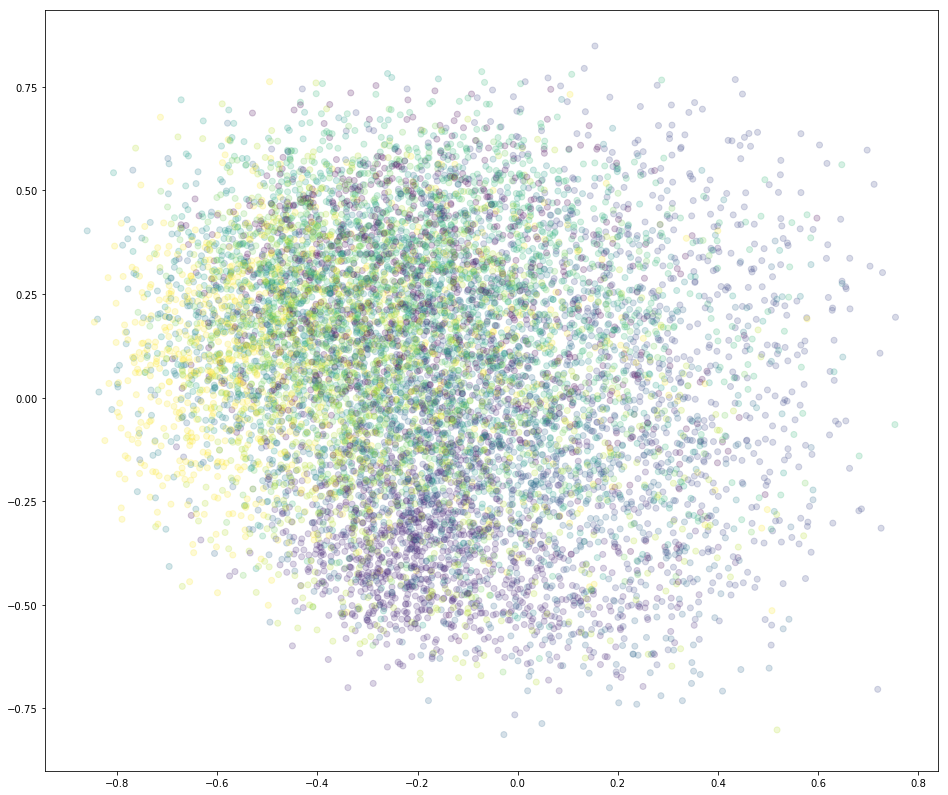

  Epoch 1 of 5 -> Cost: 135.022198752
  X: [ 0.12662609  0.04816293  0.39623463 ...,  0.48419878  0.42584386
 -0.4483068 ]
  Y: [ 0.2497272   0.31945947  0.1866858  ...,  0.66370475  0.54594767
  0.63269228]


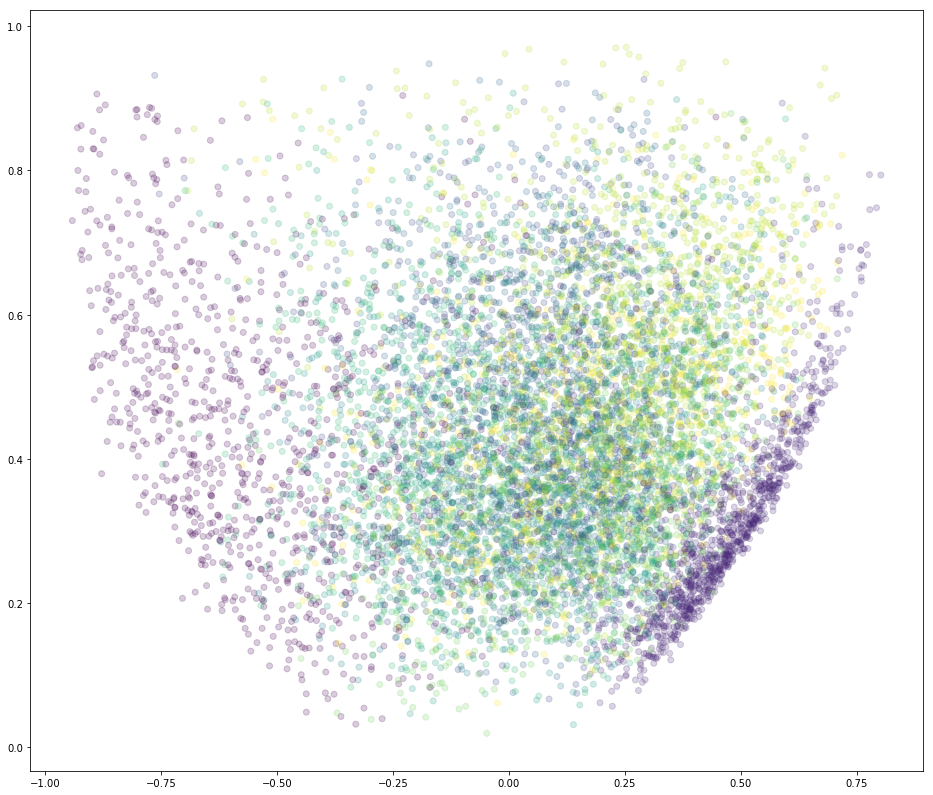

  Epoch 2 of 5 -> Cost: 131.611331195
  X: [ 0.08104331  0.36614642  0.64273852 ...,  0.24074145  0.4643034
 -0.27671847]
  Y: [ 0.12267403  0.53007406  0.31790179 ...,  0.25840831  0.497621    0.6670481 ]


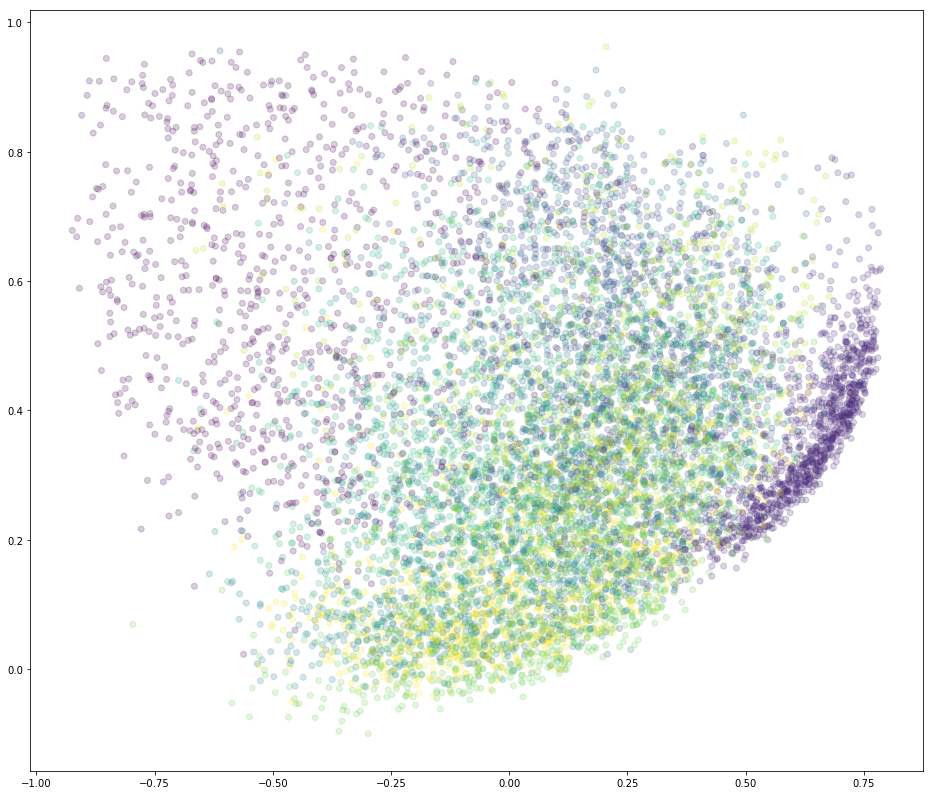

  Epoch 3 of 5 -> Cost: 130.469853848
  X: [ 0.02391506  0.42167869  0.70709509 ...,  0.09973715  0.31902203
 -0.47369072]
  Y: [-0.06199882  0.74011487  0.34005693 ...,  0.04367587  0.29666054
  0.57502198]


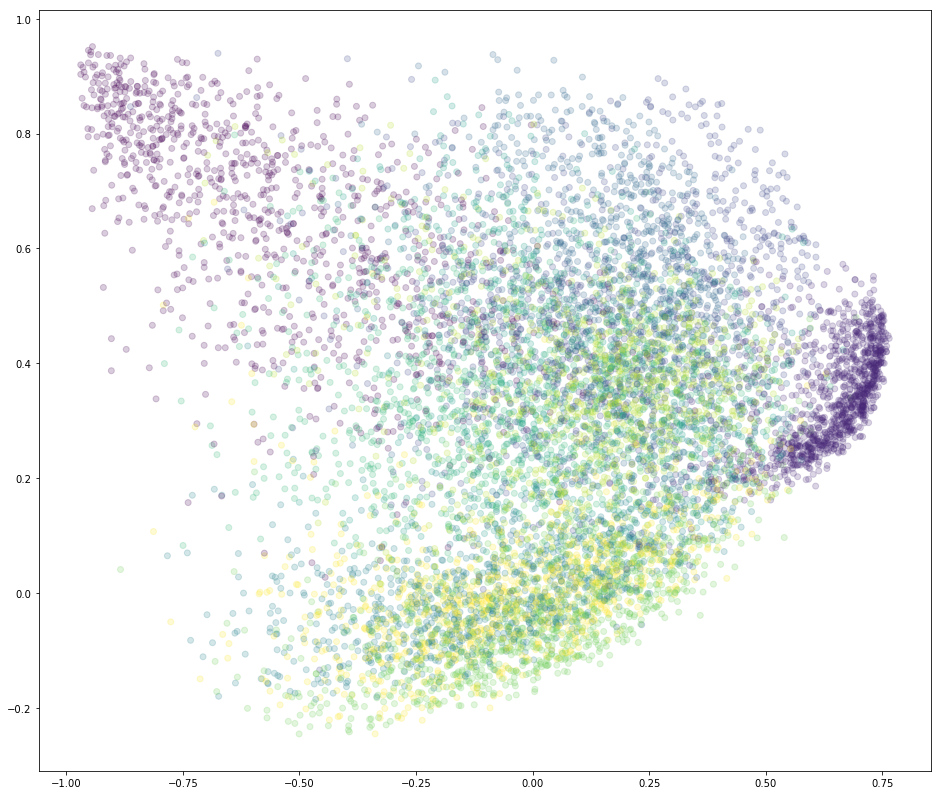

  Epoch 4 of 5 -> Cost: 128.950355232
  X: [ 0.0720777   0.59027243  0.78109843 ...,  0.09001349  0.3897154
 -0.46606112]
  Y: [-0.10035479  0.79737711  0.28571463 ...,  0.07024787  0.23649336
  0.59916019]


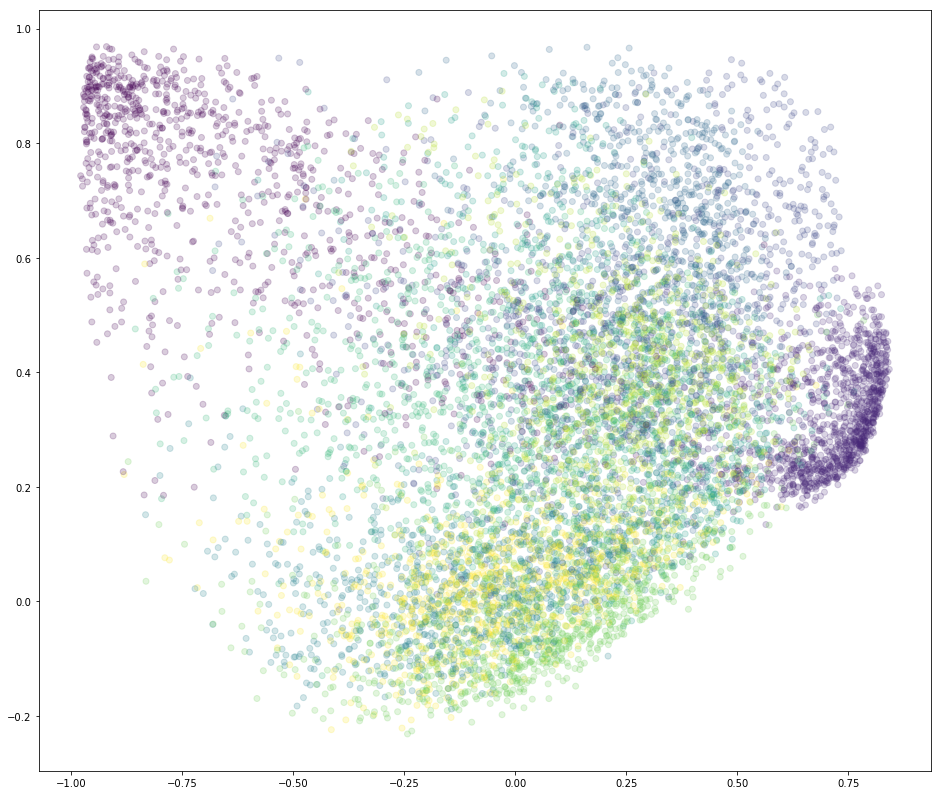

  Epoch 5 of 5 -> Cost: 127.980238095
  X: [ 0.12275965  0.64765775  0.92441344 ...,  0.19196077  0.44401285
 -0.31030011]
  Y: [-0.15188055  0.79169118  0.21533515 ...,  0.00095047  0.19335604
  0.47839248]


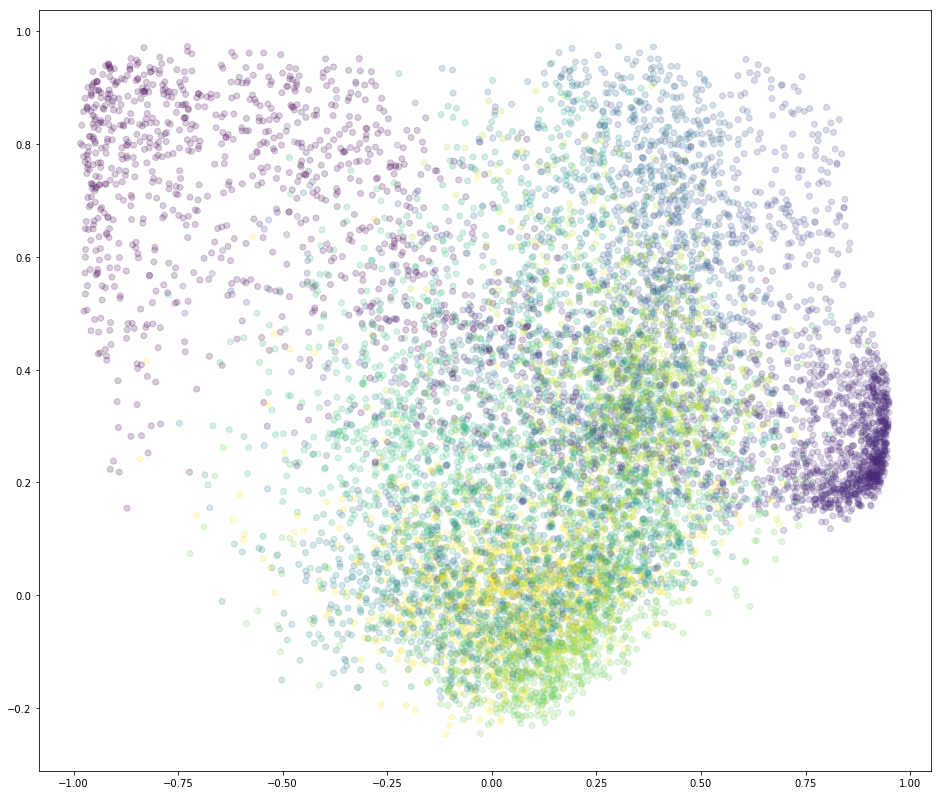

<module 'matplotlib.pyplot' from '/home/endre/anaconda3/envs/endre-tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py'>

In [41]:
# Train the Autoencoder with RANDOM WEIGHTS!

# TANH: The initial scatter is very nicely distributed in a large blob around origo.
#       Already observable group tendencies.
#       However, usually collapse at point (-1, -1), but line y=1 seen. Strange

trainAutoencoderAndPlot(tf.nn.tanh, epochs=autoencoder_epochs)